In [1]:
%load_ext autoreload
%autoreload 2
import infercnvpy as cnv
import scanpy as sc
from scanpy_helpers.annotation import AnnotationHelper
import scvi
import warnings

warnings.filterwarnings("ignore", category=FutureWarning)

INFO:numexpr.utils:Note: NumExpr detected 64 cores but "NUMEXPR_MAX_THREADS" not set, so enforcing safe limit of 8.
INFO:get_version:dirname: Trying to get version of get_version from dirname /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:dirname: Failed; Does not match re.compile('get[_-]version-([\\d.]+?)(?:\\.dev(\\d+))?(?:[_+-]([0-9a-zA-Z.]+))?$')
INFO:get_version:git: Trying to get version from git in directory /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:git: Failed; directory is not managed by git
INFO:get_version:metadata: Trying to get version for get_version in dir /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:metadata: Succeeded
INFO:get_version:dirname: Trying to get version of legacy_api_wrap from dirname /home/sturm/.conda/envs/pircher-sc-infercnv/lib/python3.8/site-packages
INFO:get_version:dirname: Failed; Does not match re.compile('legacy[_-]

In [2]:
ah = AnnotationHelper()

In [3]:
sc.set_figure_params(figsize=(5, 5))

In [4]:
adata = sc.read_h5ad(
    "../../data/50_integrate_scrnaseq_data/52_run_scanvi/integrated_merged_all.h5ad"
)

In [5]:
adata.shape

(551334, 18095)

In [6]:
scvi_model = scvi.model.SCANVI.load(
    "../../data/50_integrate_scrnaseq_data/52_run_scanvi/scvi_model_merged_all/",
    adata=adata,
)

INFO     Using data from adata.X                                                             
INFO     Computing library size prior per batch                                              
INFO     Registered keys:['X', 'batch_indices', 'local_l_mean', 'local_l_var', 'labels']     
INFO     Successfully registered anndata object containing 551334 cells, 18095 vars, 360     
         batches, 50 labels, and 0 proteins. Also registered 0 extra categorical covariates  
         and 0 extra continuous covariates.                                                  


In [8]:
adata_infercnv = sc.AnnData(
    X=adata.raw.X,
    var=adata.raw.var,
    obs=adata.obs,
    obsm=adata.obsm,
    uns=adata.uns,
    obsp=adata.obsp,
    layers={"imputed": scvi_model.get_normalized_expression(library_size=10000)}
)

In [9]:
cnv.io.genomic_position_from_gtf(
    "/data/genomes/hg38/annotation/gencode/gencode.v33.primary_assembly.annotation.gtf",
    adata_infercnv,
)

INFO:root:Extracted GTF attributes: ['gene_id', 'gene_name']


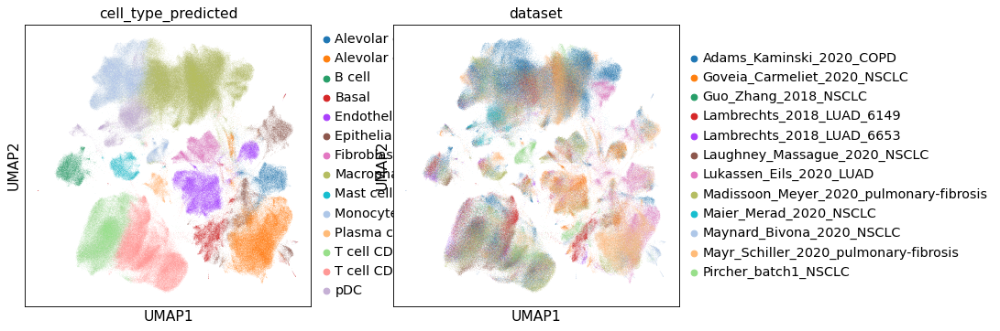

In [10]:
sc.pl.umap(adata, color=["cell_type_predicted", "dataset"])

In [11]:
sc.pp.neighbors(adata, use_rep="X_scANVI", n_neighbors=30)
sc.tl.umap(adata)

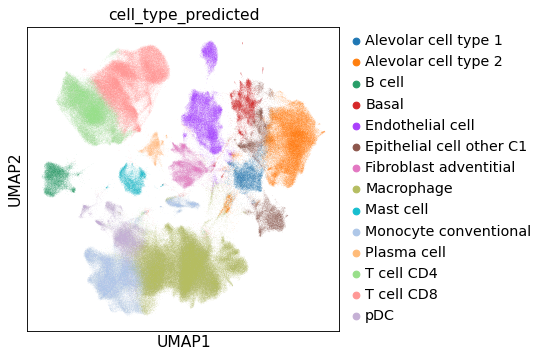

In [14]:
sc.pl.umap(adata, color="cell_type_predicted")

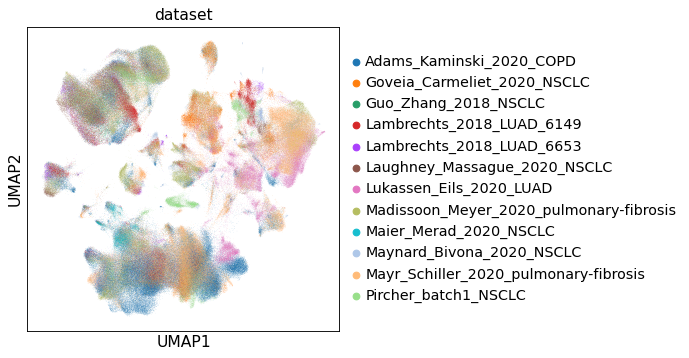

In [15]:
sc.pl.umap(adata, color=["dataset"])

In [16]:
%%time
cnv.tl.infercnv(
    adata_infercnv,
    reference_key="cell_type_predicted",
    reference_cat=[
        "T cell CD4",
        "T cell CD8",
        "Monocyte conventional",
        "Macrophage",
        "Mast cell",
        "Plasma cell",
        "B cell",
        "pDC",
    ],
    window_size=250,
)

  0%|          | 0/111 [00:00<?, ?it/s]

CPU times: user 1min 32s, sys: 1min 4s, total: 2min 37s
Wall time: 3min 9s


In [17]:
adata = adata_infercnv

In [18]:
cnv.tl.pca(adata)
cnv.pp.neighbors(adata)
cnv.tl.umap(adata)

In [19]:
cnv.tl.leiden(adata, resolution=1.5)

In [20]:
cnv.tl.cnv_score(adata)

... storing 'chromosome' as categorical
... storing 'gene_id' as categorical
... storing 'gene_name' as categorical


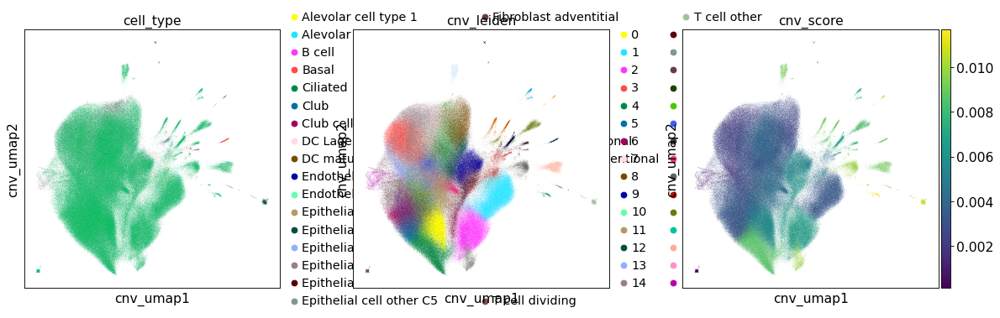

In [21]:
cnv.pl.umap(adata, color=["cell_type", "cnv_leiden", "cnv_score"])

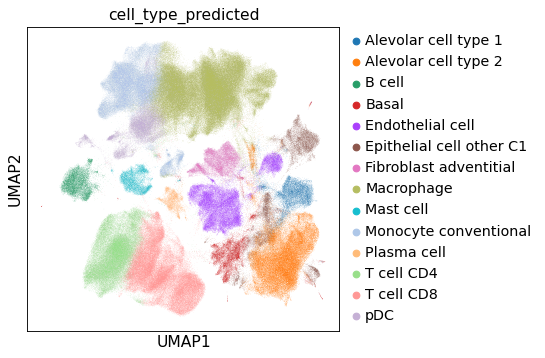

In [22]:
sc.pl.umap(adata, color="cell_type_predicted")

In [23]:
sc.tl.leiden(adata)

In [26]:
adata.write_h5ad("/home/sturm/Downloads/tmp_adata_61.h5ad")

In [27]:
adata = sc.read_h5ad("/home/sturm/Downloads/tmp_adata_61.h5ad")

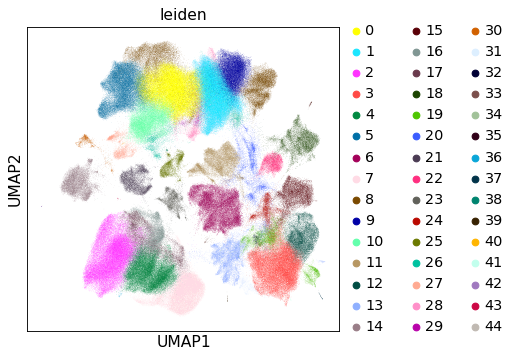

In [28]:
sc.pl.umap(adata, color="leiden")

Alevolar cell type 1


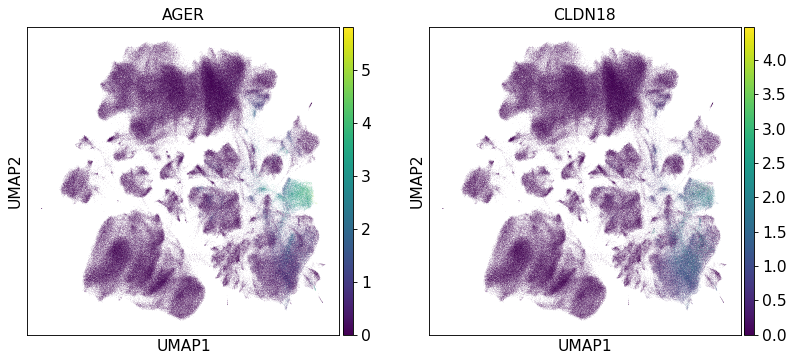

Alevolar cell type 2


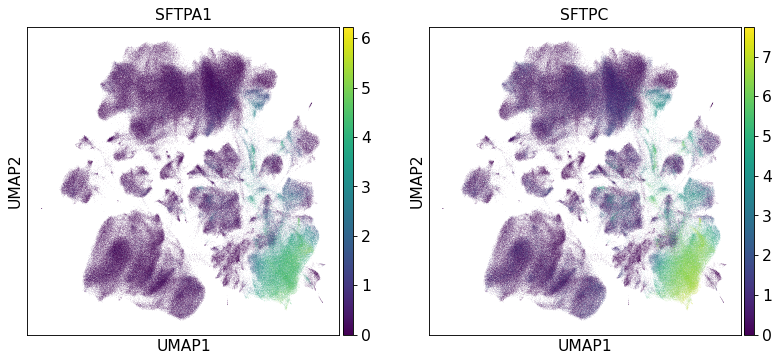

Alevolar cells (type 1 and 2)


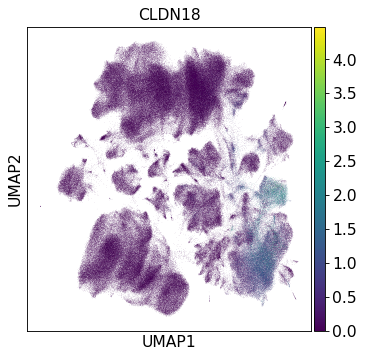

B cell


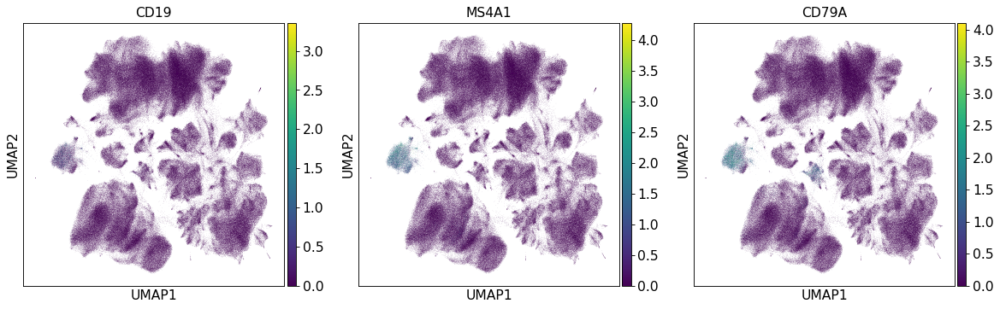

Basal


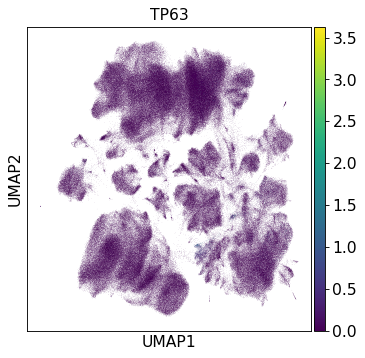

Ciliated


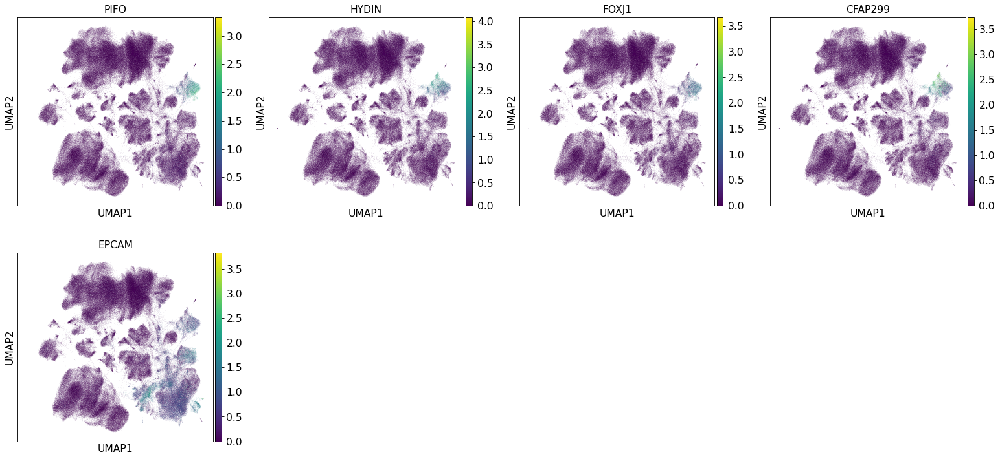

Club


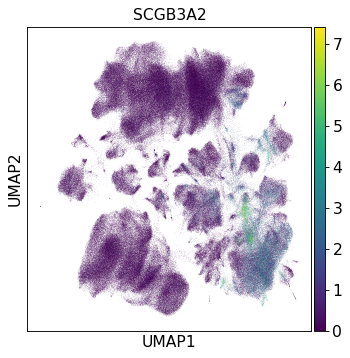

DC Lagerhans


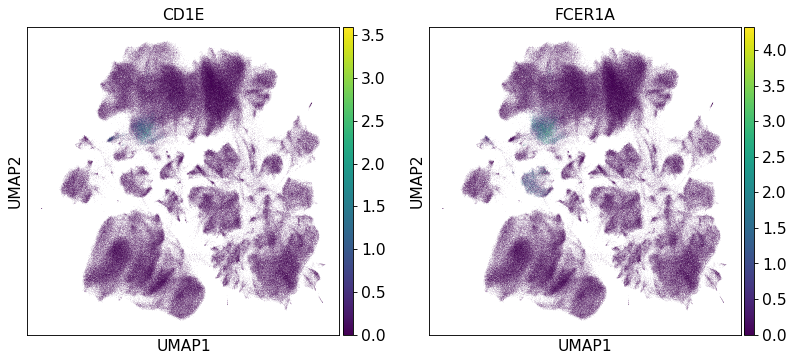

DC mature


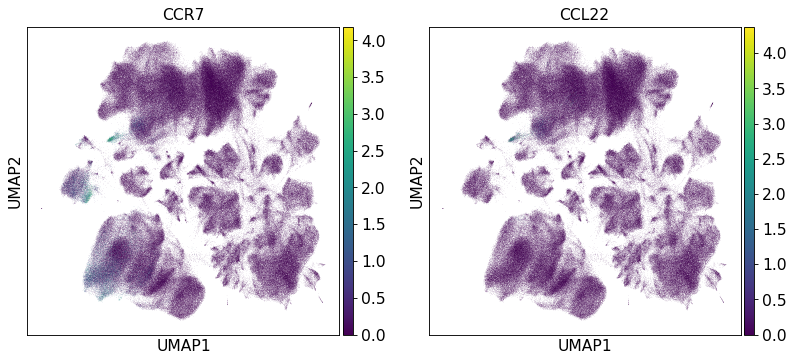

Dividing


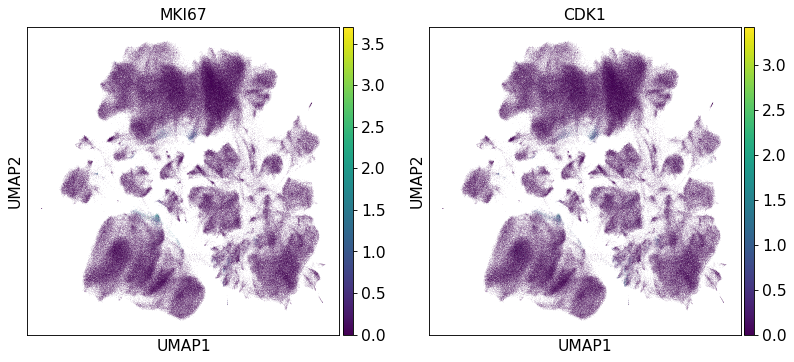

Endothelial cell


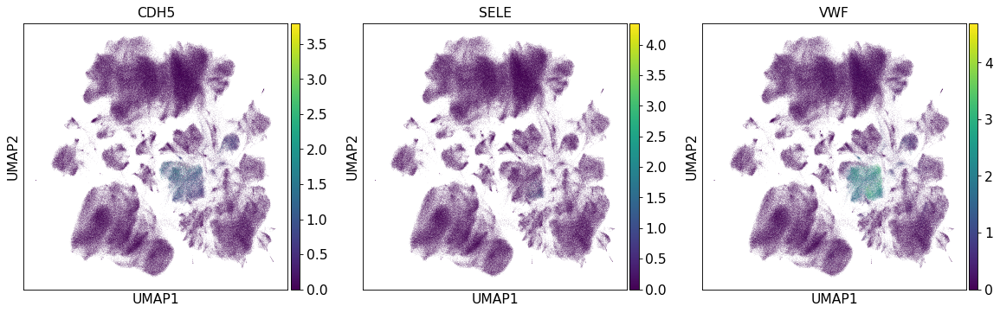

Endothelial cell lymphatic


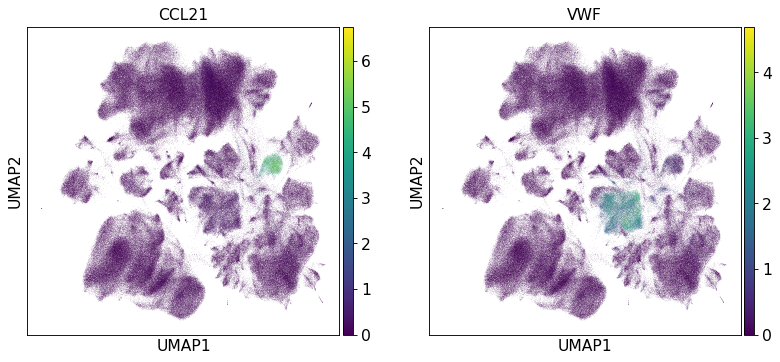

Epithelial


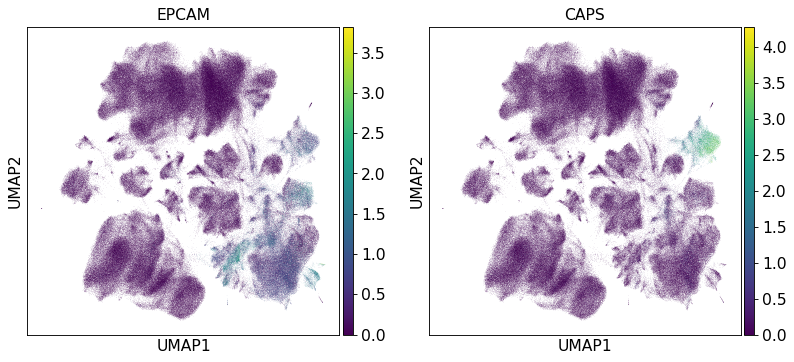

Fibroblast


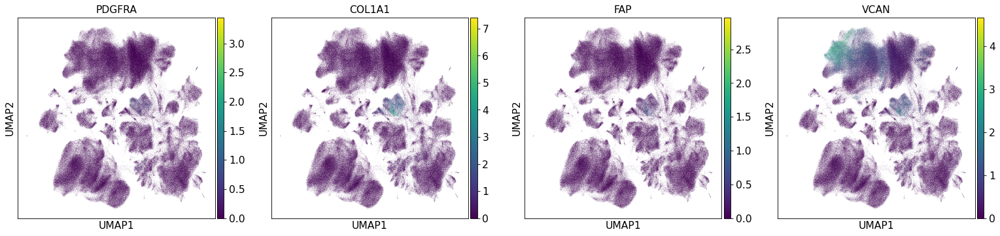

Fibroblast adventitial


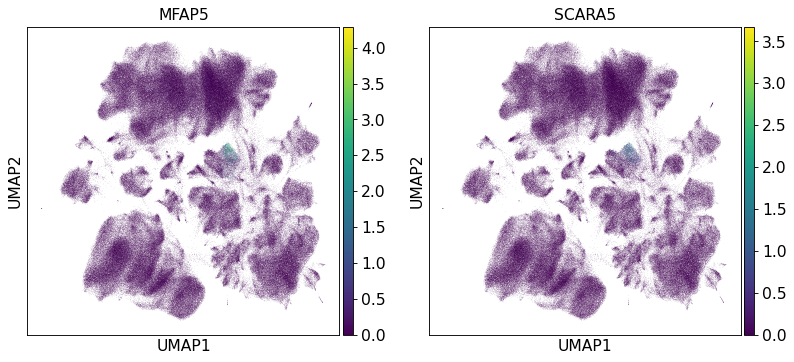

Fibroblast alveolar


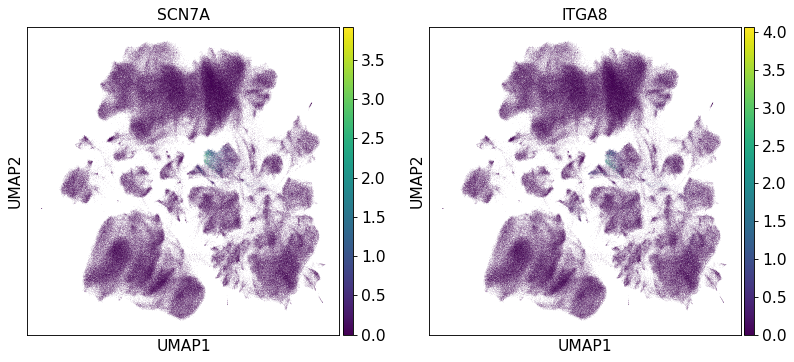

Goblet


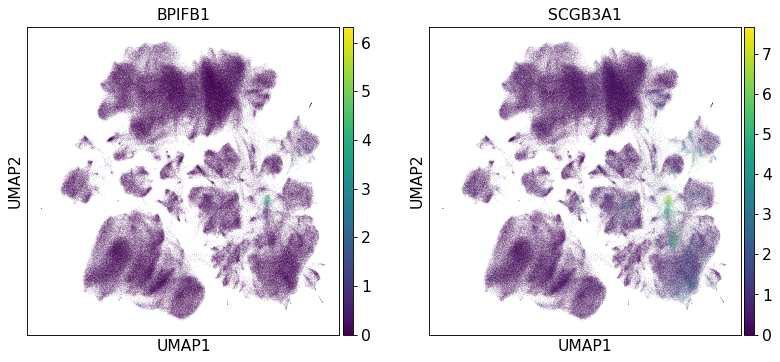

Ionocyte


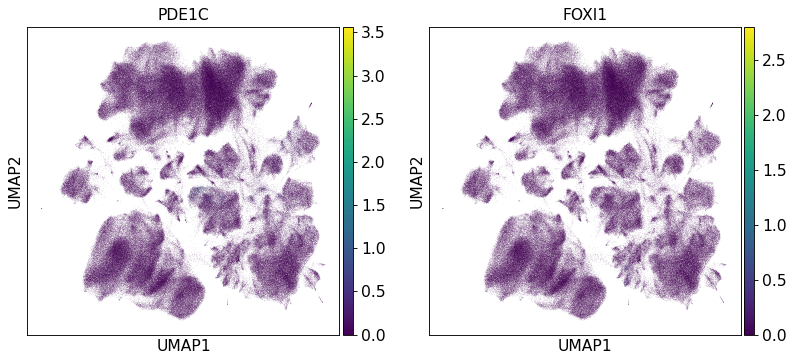

MDSC


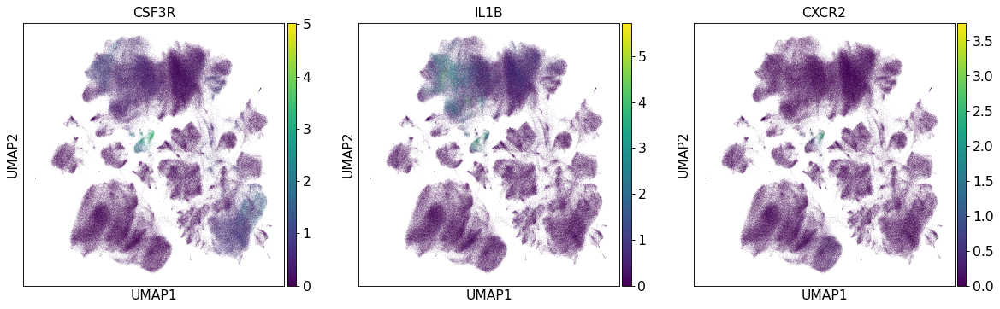

Macrophage


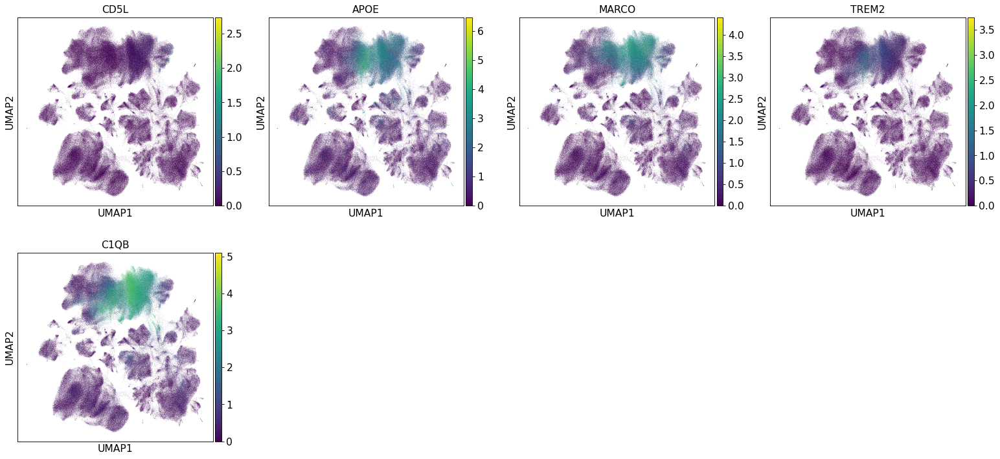

Macrophage alveolar


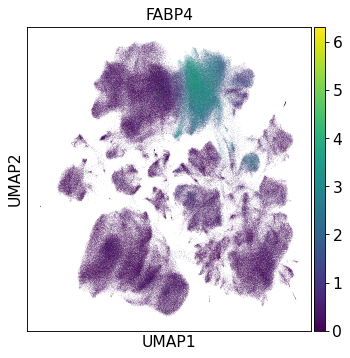

Mast cells


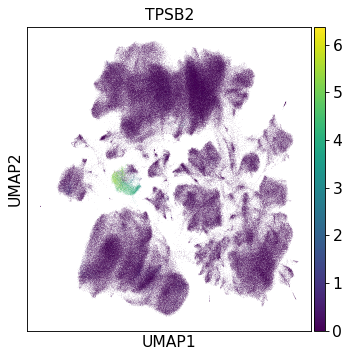

Mesothelial


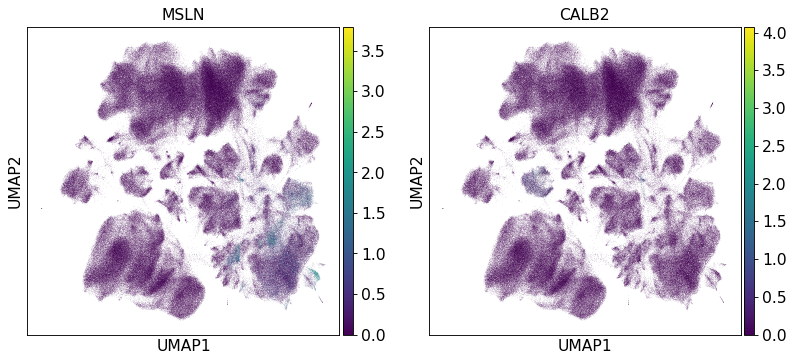

Monocyte


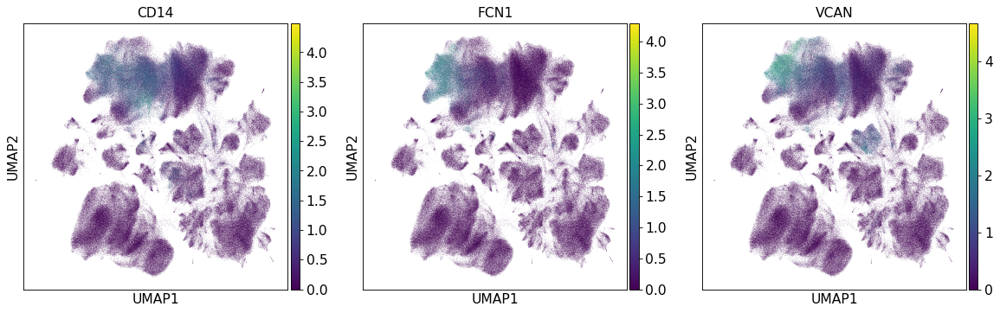

Monocyte conventional


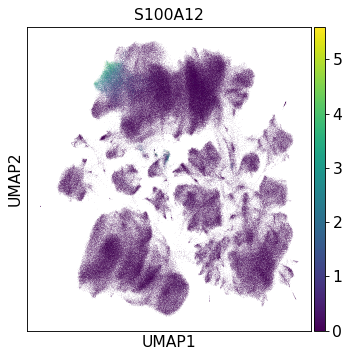

Monocyte non-coventional


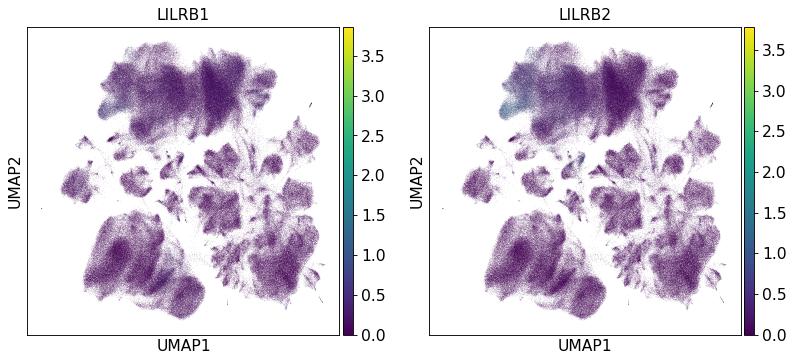

NK cell


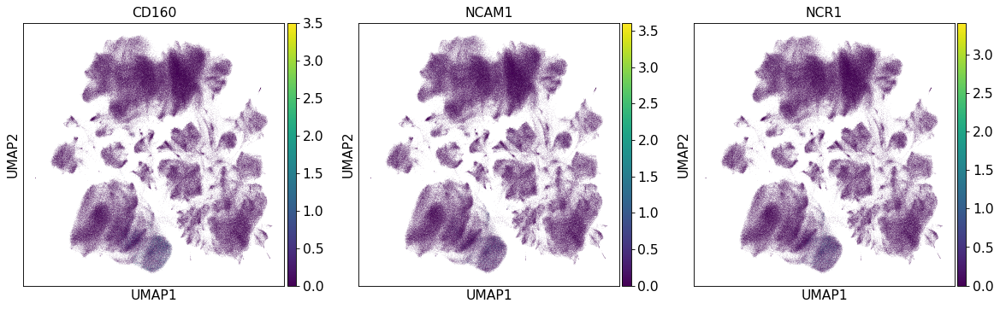

Pericyte


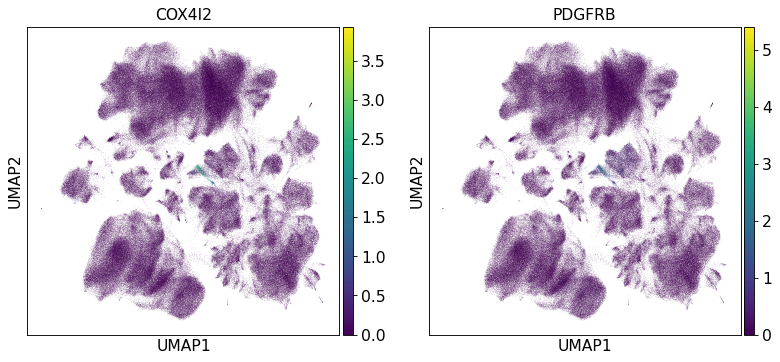

Plasma cell


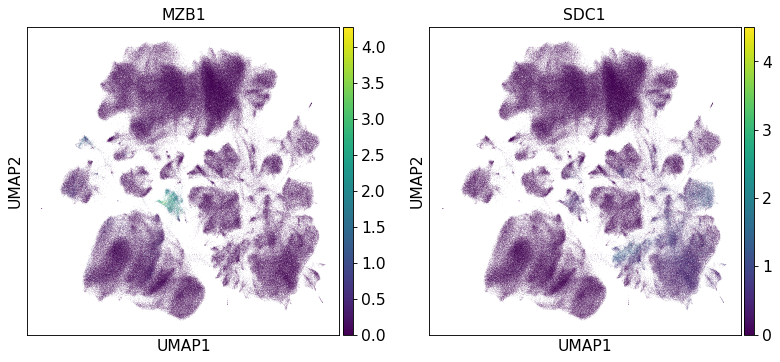

Pulmonary neuroendocrine cell


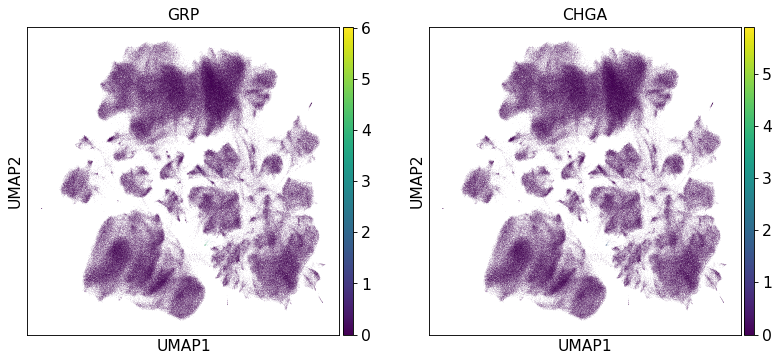

Smooth muscle cell


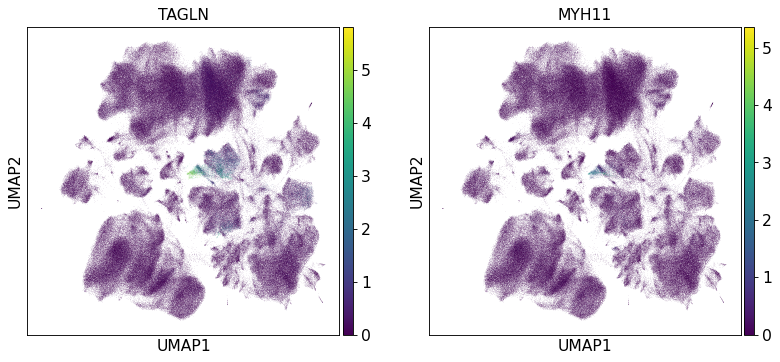

Suprabasal


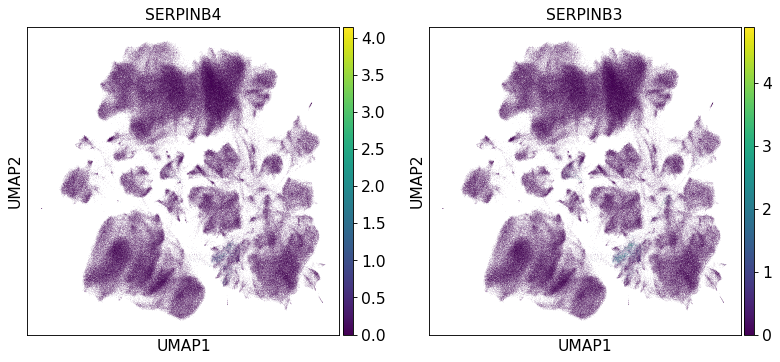

T cell


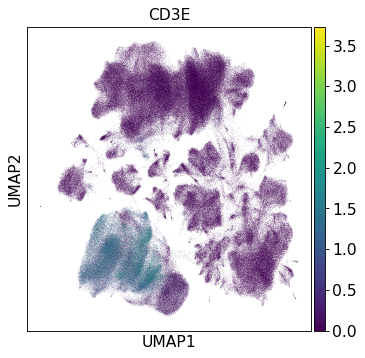

T cell CD4


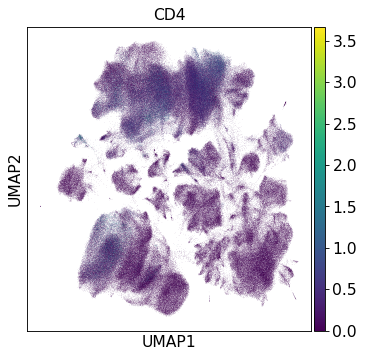

T cell CD8


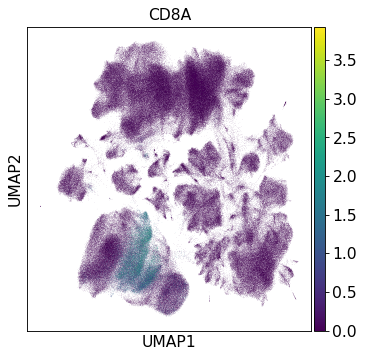

T cell cytotoxic


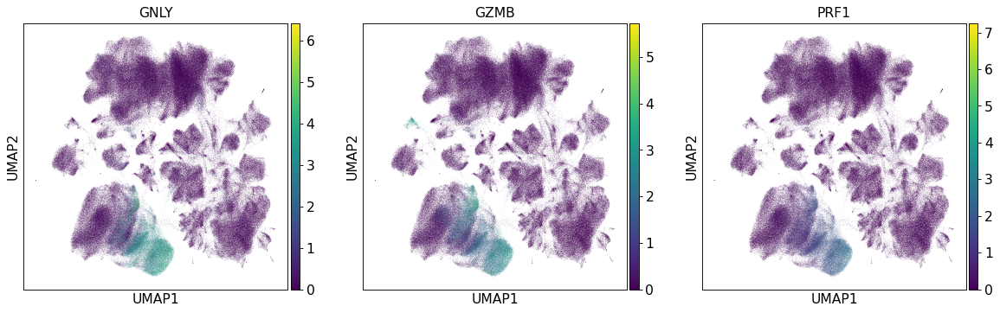

T cell regulatory


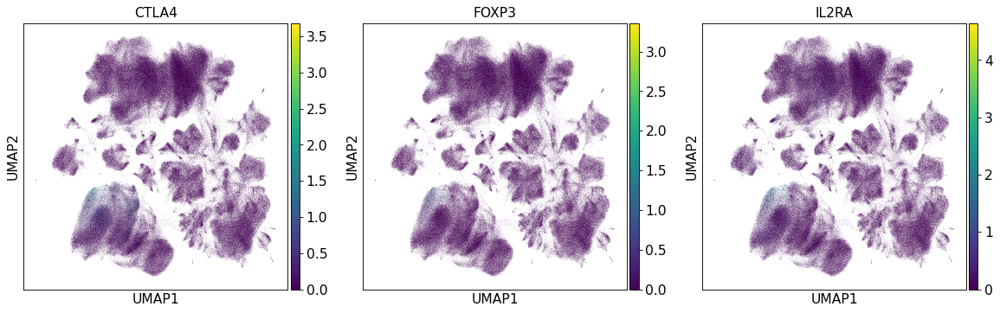

Vessel


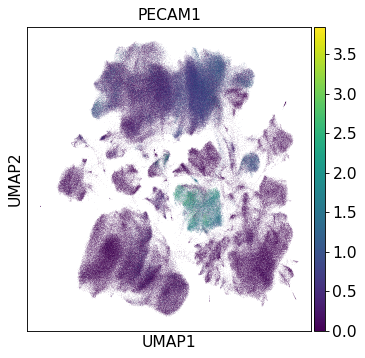

cDC1


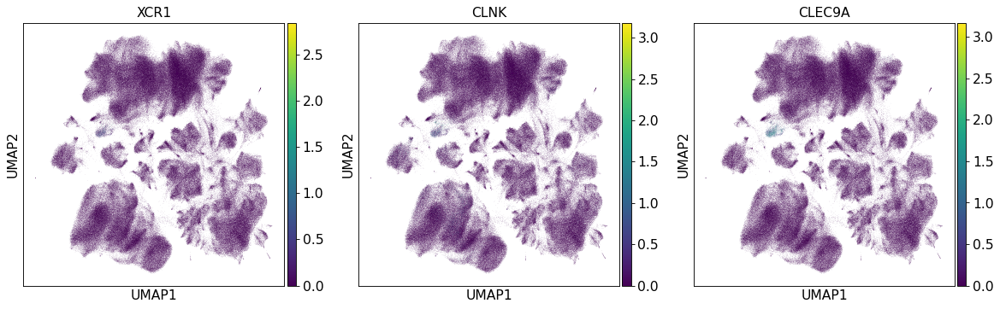

cDC2


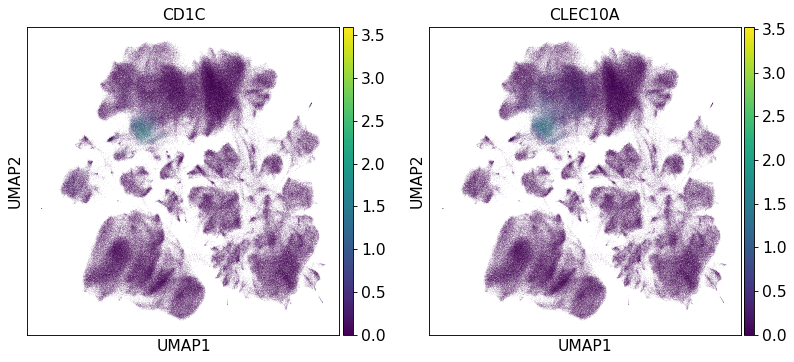

pDC


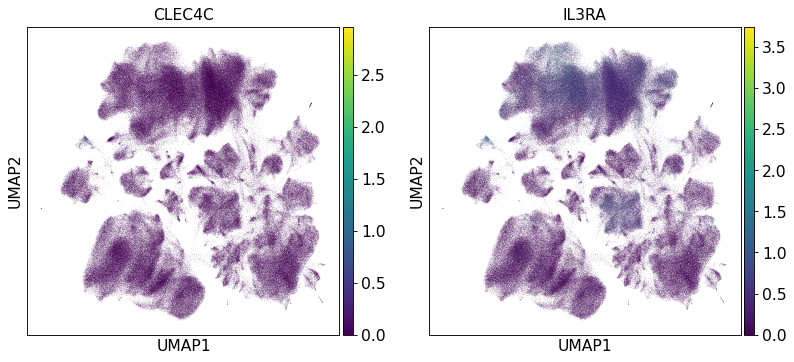

In [29]:
ah.plot_umap(adata)

Marker MIR205HG for Basal not in adata.var


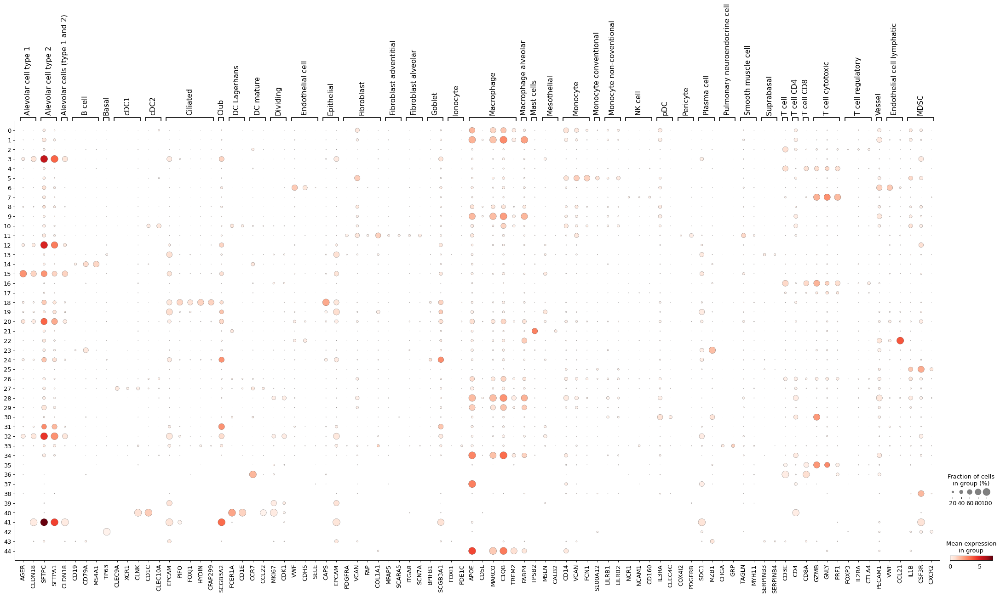

In [30]:
ah.plot_dotplot(adata)

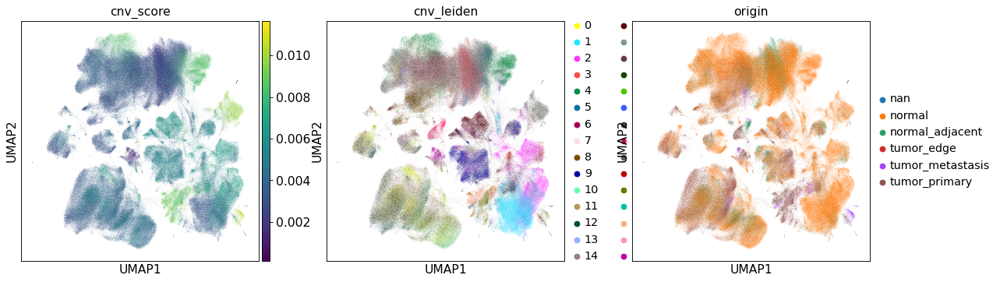

In [31]:
sc.pl.umap(adata, color=["cnv_score", "cnv_leiden", "origin"])

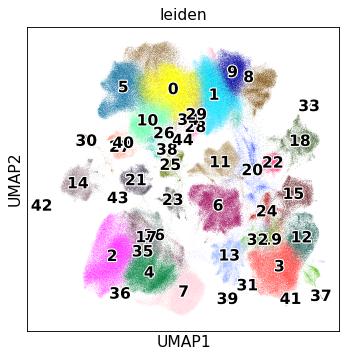

In [32]:
sc.pl.umap(adata, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [47]:
ct_map = {
    "B cell": [14],
    "Ciliated": [18],
    "Endothelial cell": [6],
    "Endothelial cell lymphatic": [22],
    "Epithelial cell": [15, 24, 21, 19, 3, 37, 13, 31, 20, 12, 32],
    "Mast cell": [21],
    "Myeloid": [4, 0, 10, 1, 9, 29, 34, 28, 44, 26, 5, 8, 25, 40, 27, 38],
    "Stromal": [11],
    "Plasma cell": [23],
    "T cell": [2, 36, 17, 16, 35, 4, 7],
    "pDC": [30],
}

... storing 'cell_type' as categorical


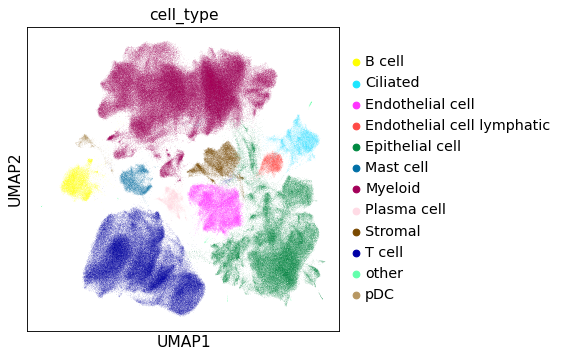

In [48]:
ah.annotate_cell_types(adata, ct_map)

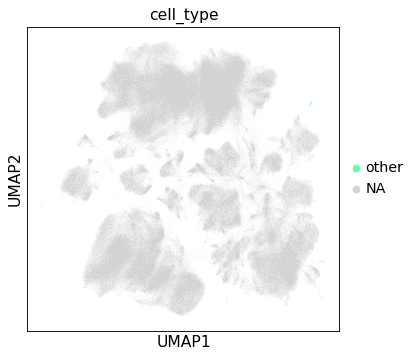

In [49]:
sc.pl.umap(adata, color="cell_type", groups=["other"])

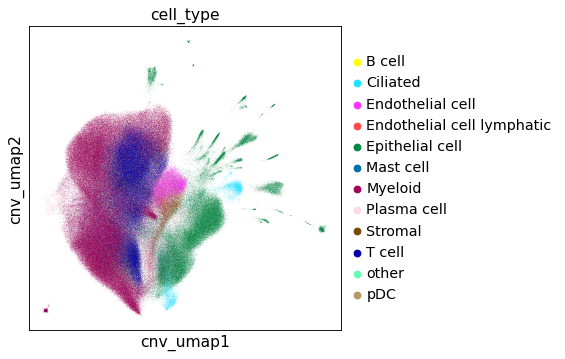

In [50]:
cnv.pl.umap(adata, color="cell_type")

In [51]:
adata_t = adata[adata.obs["cell_type"] == "T cell", :].copy()
ah.reprocess_adata_subset_scvi(adata_t, use_rep="X_scANVI", leiden_res=1.5)

Dividing


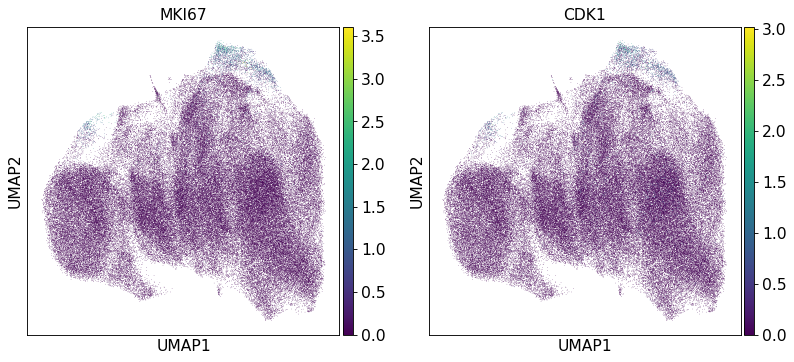

NK cell


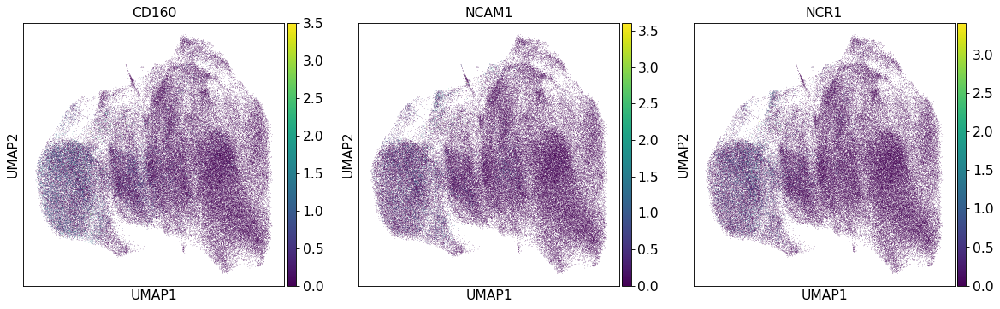

T cell


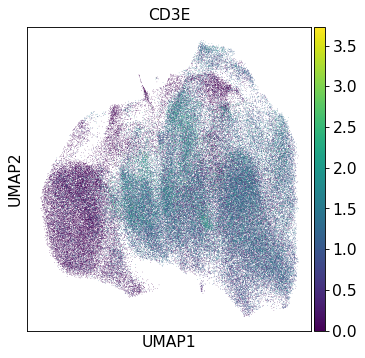

T cell CD4


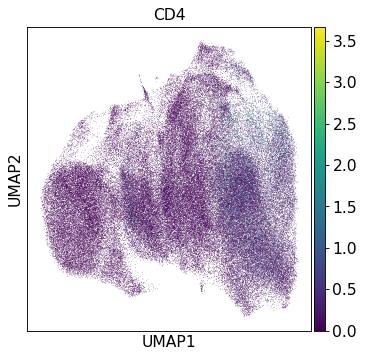

T cell CD8


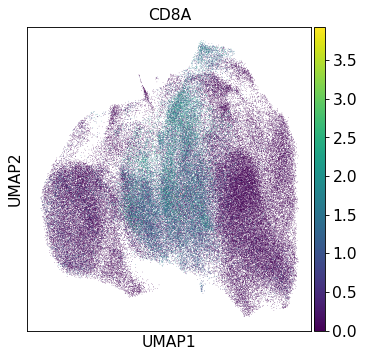

T cell cytotoxic


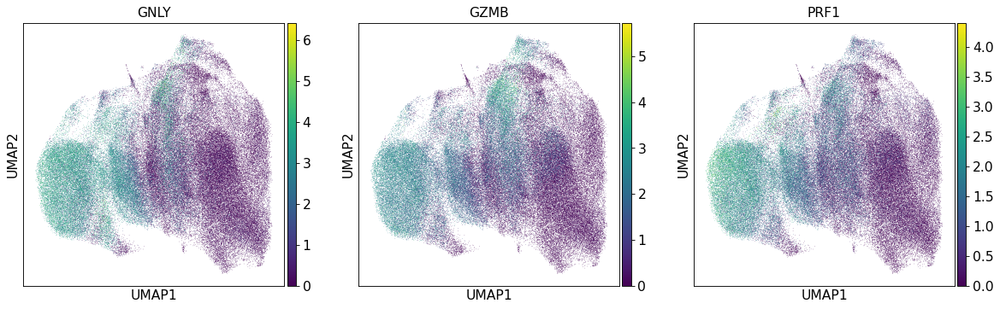

T cell regulatory


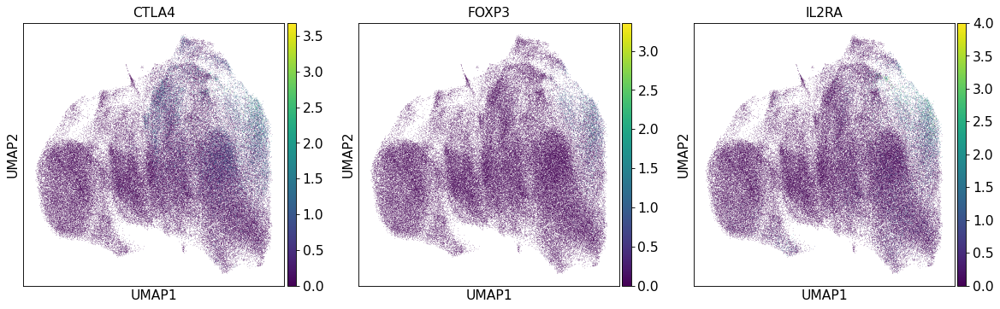

In [53]:
ah.plot_umap(adata_t, filter_cell_type=["T cell", "NK", "Div"])

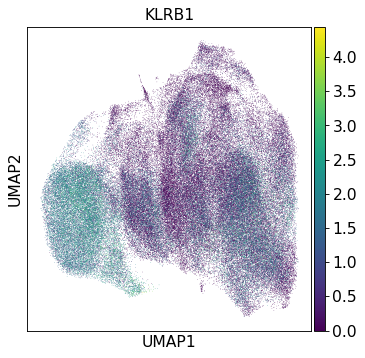

In [70]:
sc.pl.umap(adata_t, color=["KLRB1"])

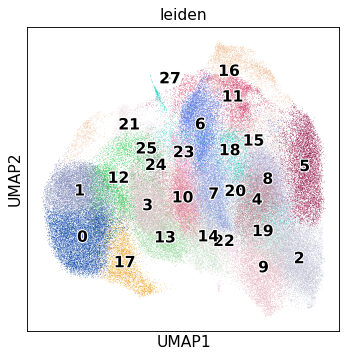

In [54]:
sc.pl.umap(adata_t, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [77]:
ct_mat = {
    "T cell dividing": [16],
    "NK cell": [1, 0, 17],
    "T cell CD8": [6, 7, 22, 14, 10, 23, 3, 13, 24, 25],
    "T reg": [5],
    "T cell CD4": [9, 2, 19, 4, 8, 15],
    "other T assoc.": [11, 12, 21, 18],
}

... storing 'cell_type' as categorical


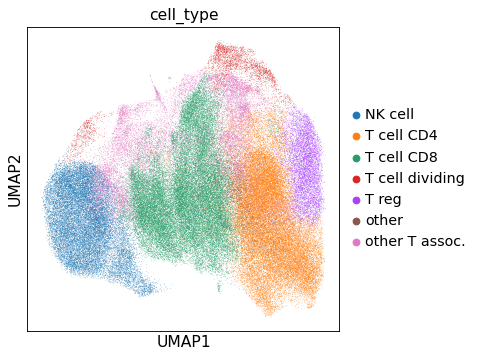

In [78]:
ah.annotate_cell_types(adata_t, ct_mat)

... storing 'cell_type' as categorical


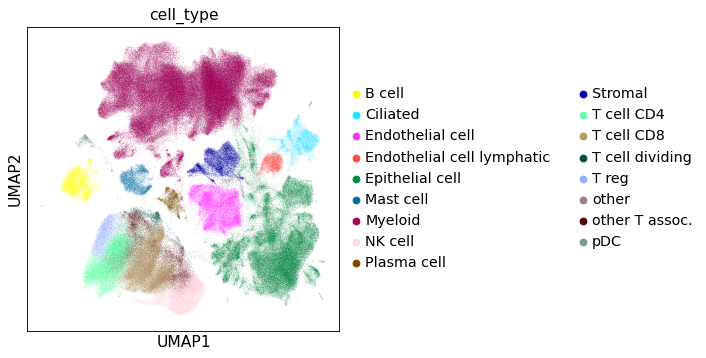

In [79]:
ah.integrate_back(adata, adata_t)

In [80]:
adata_m = adata[adata.obs["cell_type"] == "Myeloid", :].copy()
ah.reprocess_adata_subset_scvi(adata_m, use_rep="X_scANVI", n_neighbors=15)

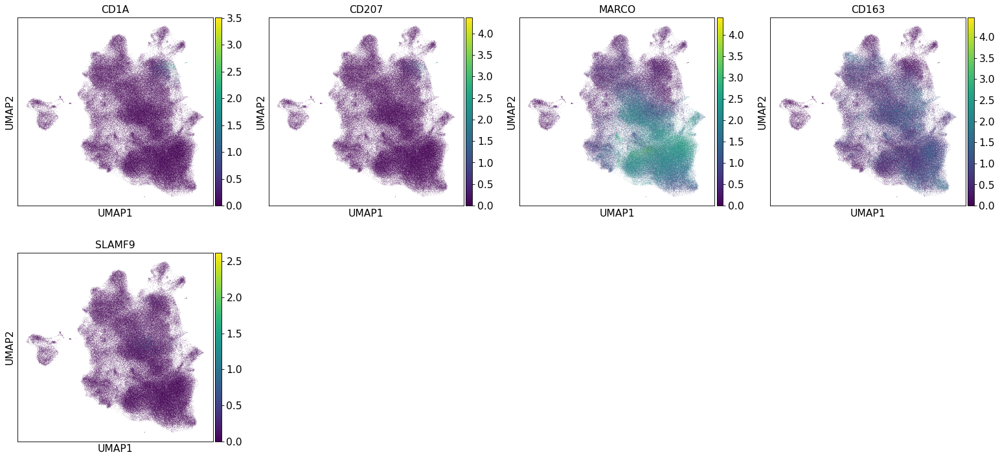

In [86]:
sc.pl.umap(adata_m, color=["CD1A", "CD207", "MARCO", "CD163", "SLAMF9"])

DC Lagerhans


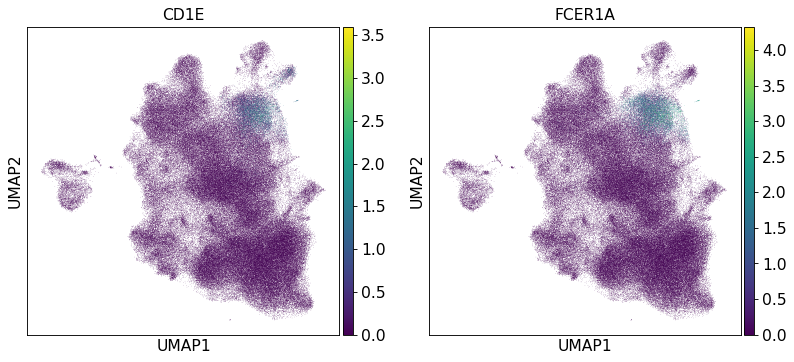

DC mature


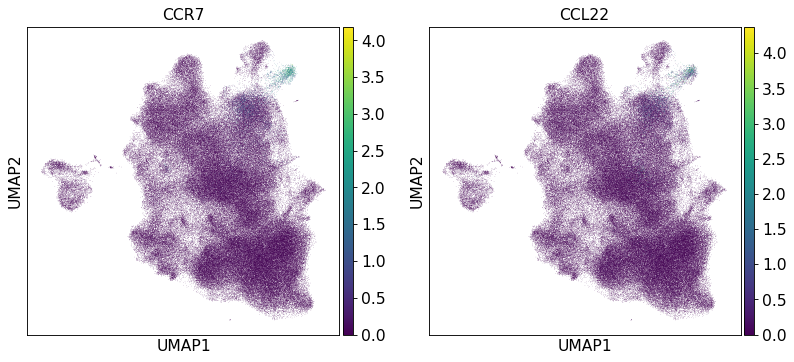

Dividing


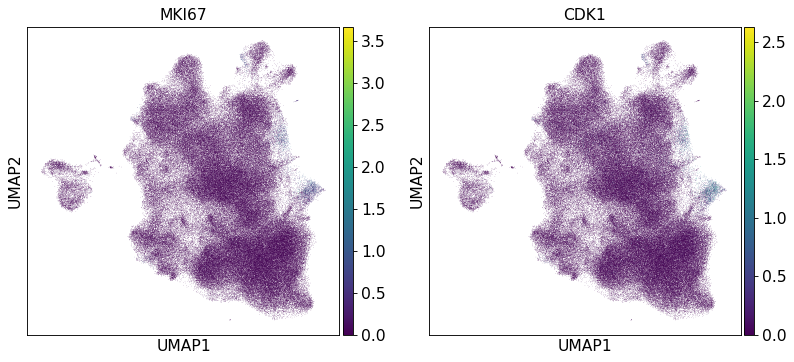

MDSC


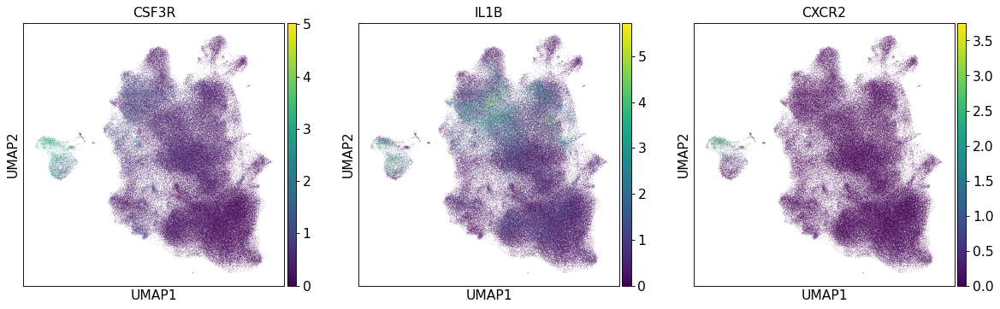

Macrophage


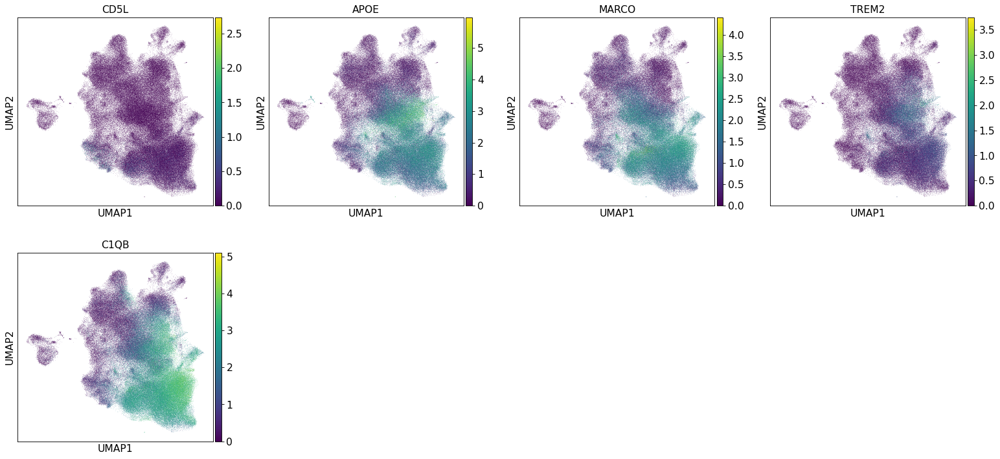

Macrophage alveolar


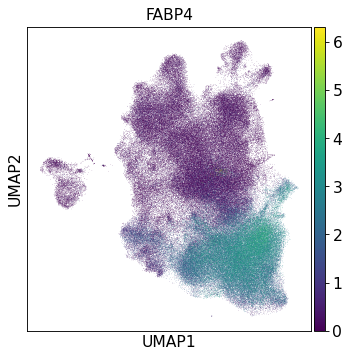

Monocyte


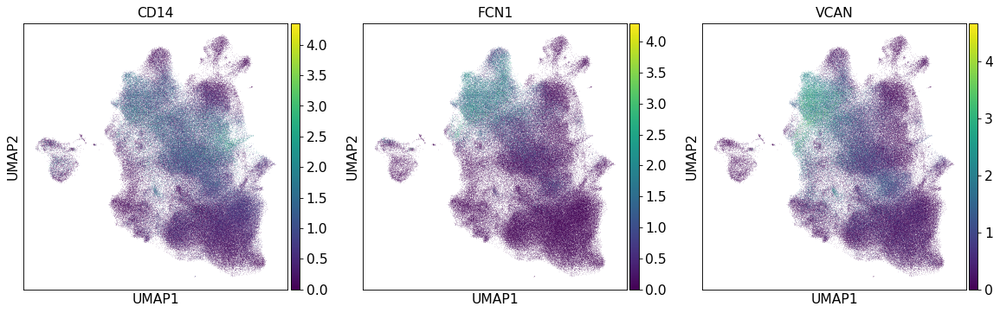

Monocyte conventional


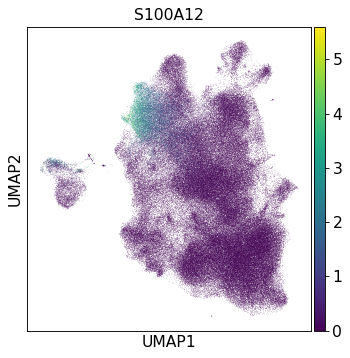

Monocyte non-coventional


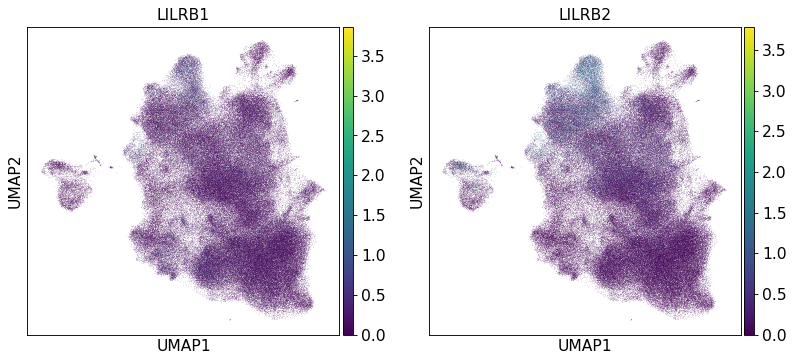

cDC1


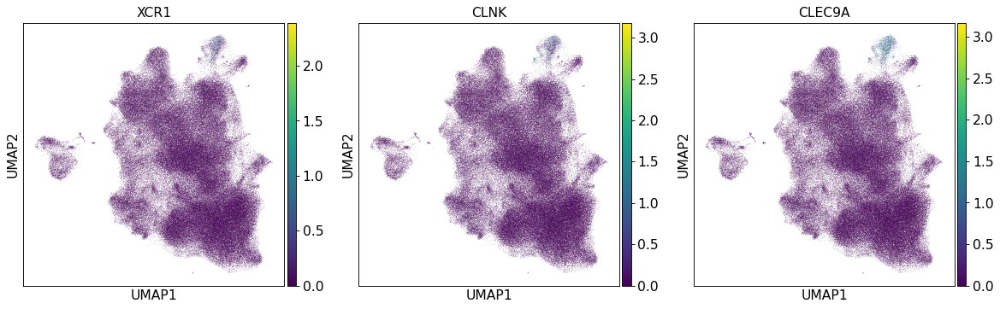

cDC2


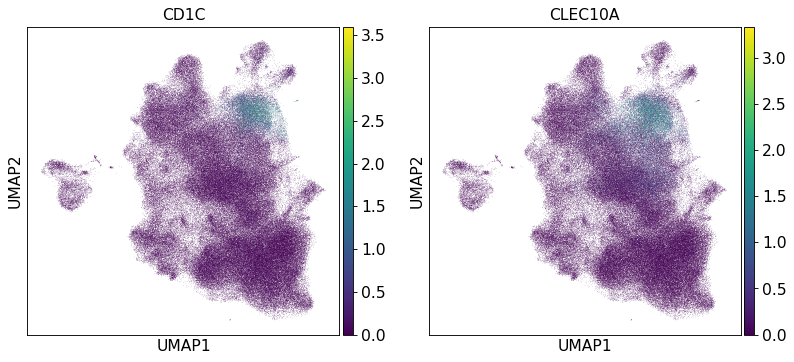

pDC


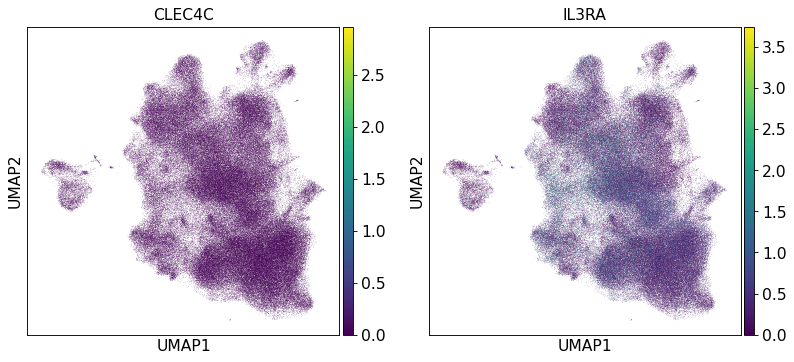

In [90]:
ah.plot_umap(adata_m, filter_cell_type=["Macro", "Mono", "DC", "Div", "MDSC"])

Marker MIR205HG for Basal not in adata.var


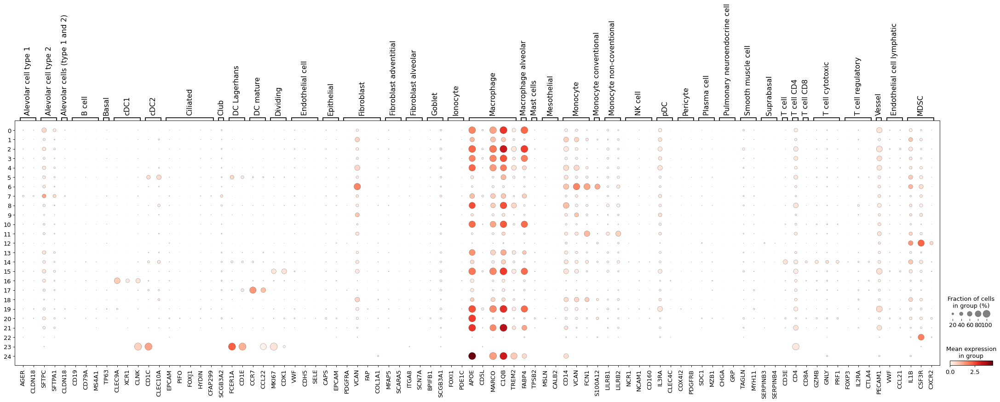

In [89]:
ah.plot_dotplot(adata_m)

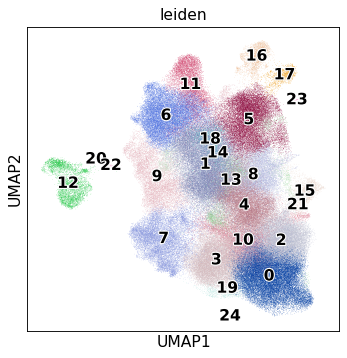

In [82]:
sc.pl.umap(adata_m, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [120]:
ct_map = {
    "mDC mature": [17],
    "cDC2": [5, 23],
    "myeloid dividing": [15, 21],
    "Macrophage FABP4+": [19, 3, 0, 2, 24, 10],
    "Macrophage": [8, 4, 1, 13, 18],
    "Monocyte conventional": [6],
    "Monocyte non-conventional": [11],
    "cDC1": [16],
    "MDSC": [12, 20, 22],
    "myeloid other": [9, 7, 14]
}

... storing 'cell_type' as categorical


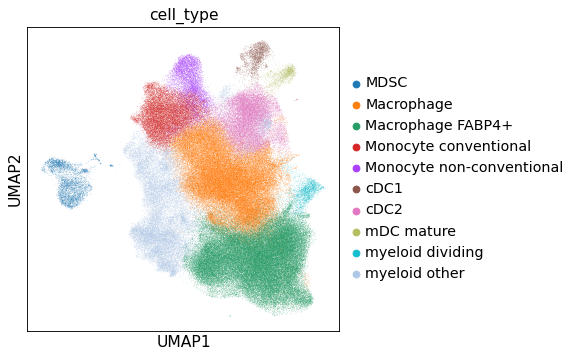

In [121]:
ah.annotate_cell_types(adata_m, ct_map)

... storing 'cell_type' as categorical


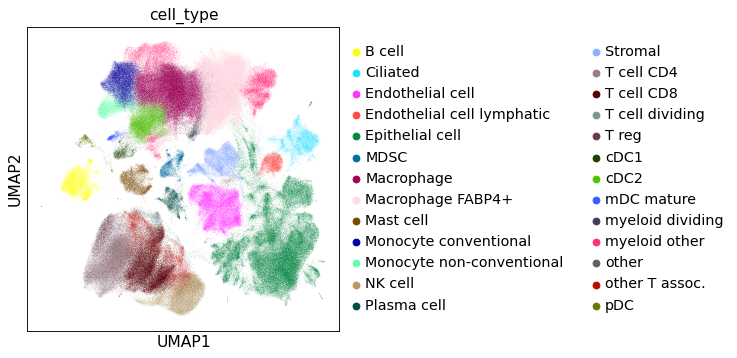

In [122]:
ah.integrate_back(adata, adata_m)

In [123]:
adata_s = adata[adata.obs["cell_type"] == "Stromal", :].copy()
ah.reprocess_adata_subset_scvi(
    adata_s, leiden_res=1, use_rep="X_scANVI", n_neighbors=15
)

Dividing


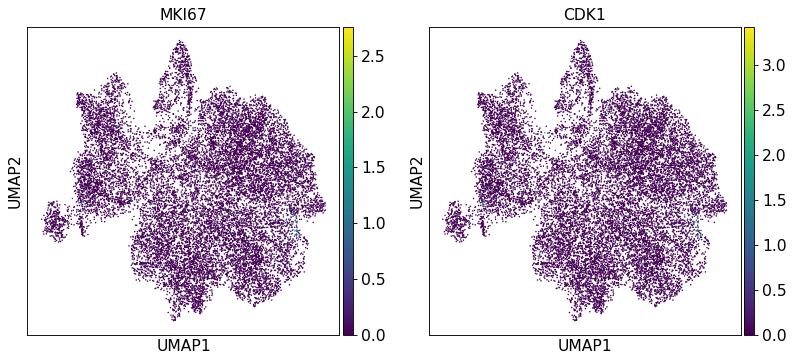

Endothelial cell


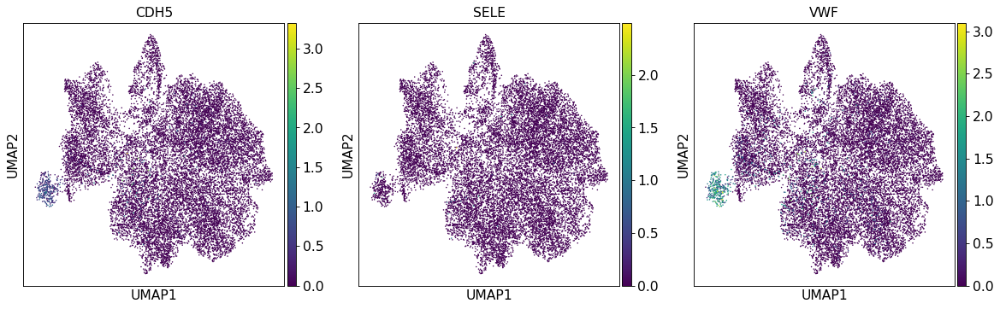

Endothelial cell lymphatic


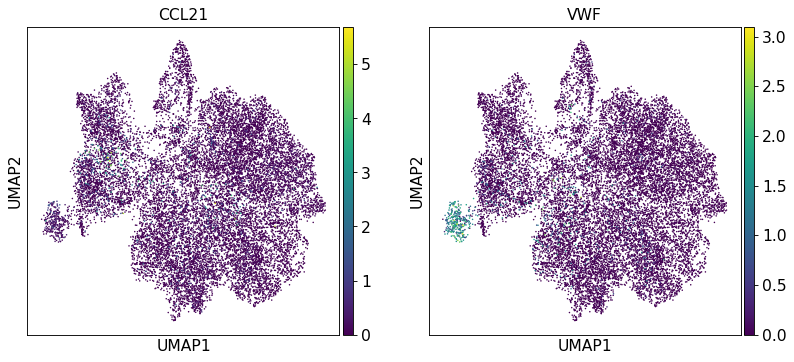

Fibroblast


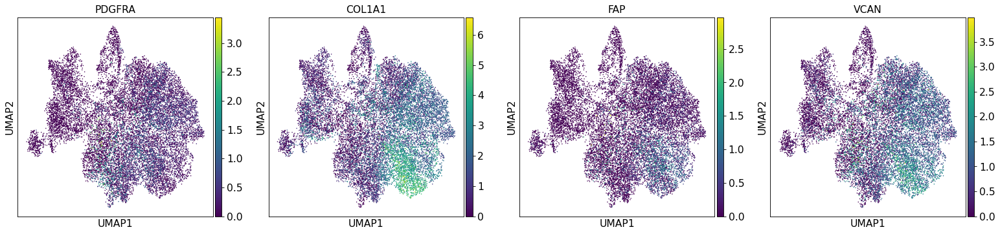

Fibroblast adventitial


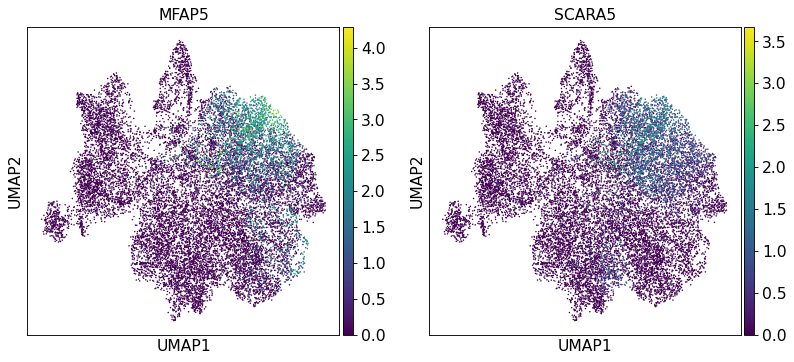

Fibroblast alveolar


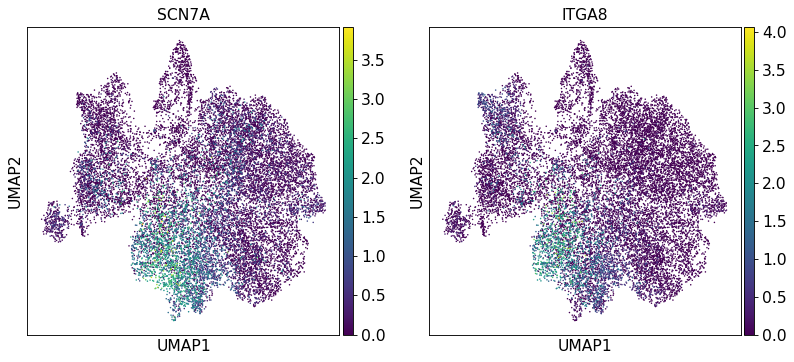

Mesothelial


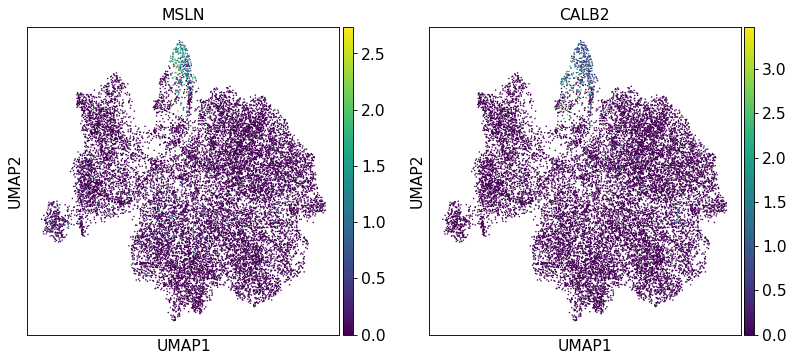

Pericyte


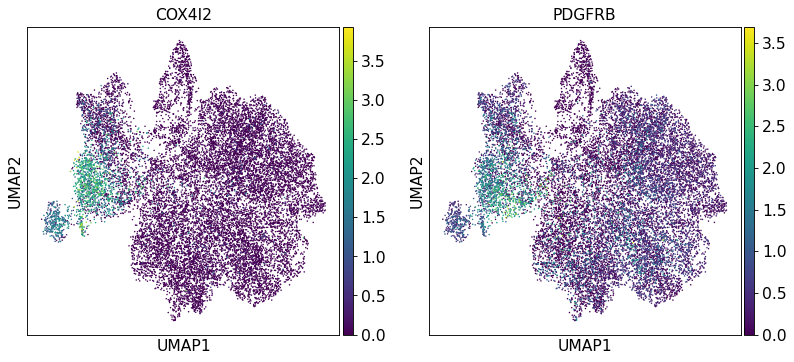

Smooth muscle cell


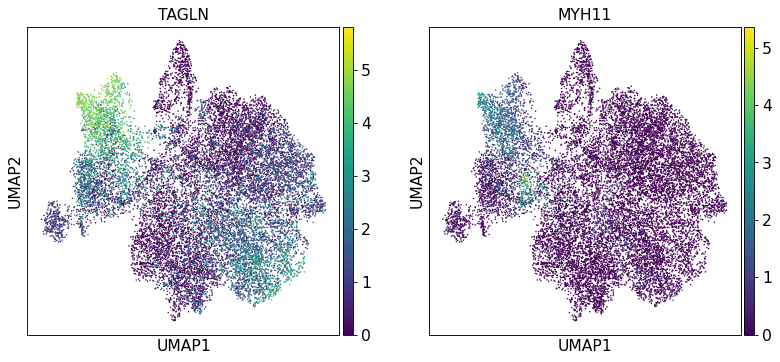

In [124]:
ah.plot_umap(
    adata_s, filter_cell_type=["Fibro", "muscle", "Peri", "Meso", "Endo", "Div"]
)

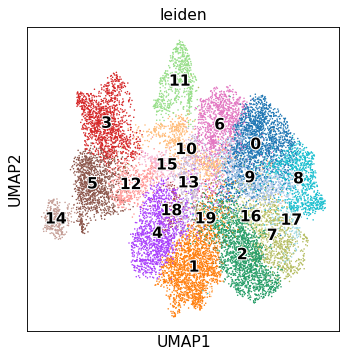

In [125]:
sc.pl.umap(adata_s, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [143]:
ct_map = {
    "Fibroblast": [2, 16, 7, 8, 17, 10, 15, 13, 19],
    "Fibroblast adventitial": [6, 0, 9],
    "Fibroblast alevolar": [4, 18, 1],
    "Smooth muscle cell": [3, 12],
    "Mesothelial": [11],
    "Pericyte": [5],
    "stromal other": [14],
}

... storing 'cell_type' as categorical


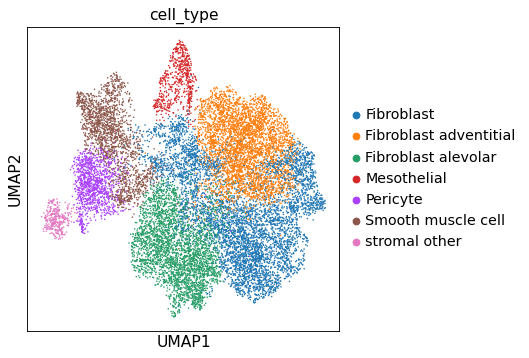

In [144]:
ah.annotate_cell_types(adata_s, ct_map)

... storing 'cell_type' as categorical


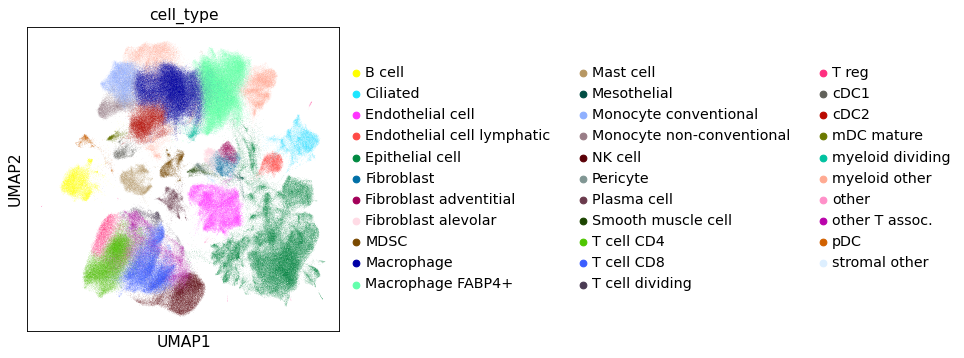

In [145]:
ah.integrate_back(adata, adata_s)

In [146]:
adata_epi = adata[adata.obs["cell_type"] == "Epithelial cell", :].copy()

In [147]:
ah.reprocess_adata_subset_scvi(adata_epi, use_rep="X_scANVI")

In [148]:
ah.reprocess_adata_subset_cnv(adata_epi)

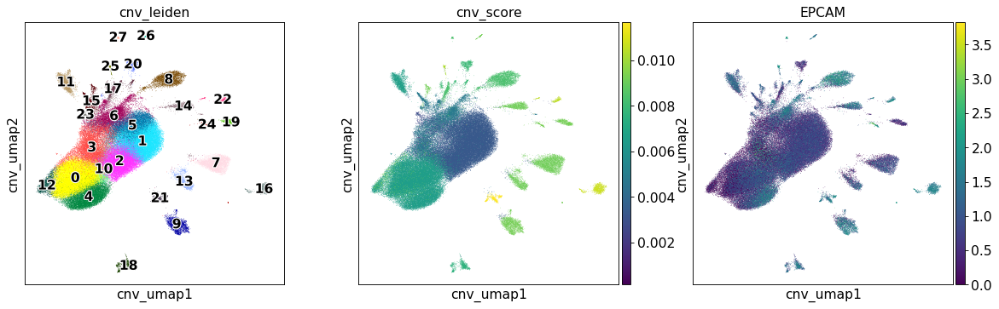

In [149]:
cnv.pl.umap(
    adata_epi,
    color=["cnv_leiden", "cnv_score", "EPCAM"],
    legend_loc="on data",
    legend_fontoutline=2,
)

In [150]:
cnv.tl.infercnv(adata_epi, reference_key="cnv_leiden", reference_cat=["4", "2", "10"])

  0%|          | 0/21 [00:00<?, ?it/s]

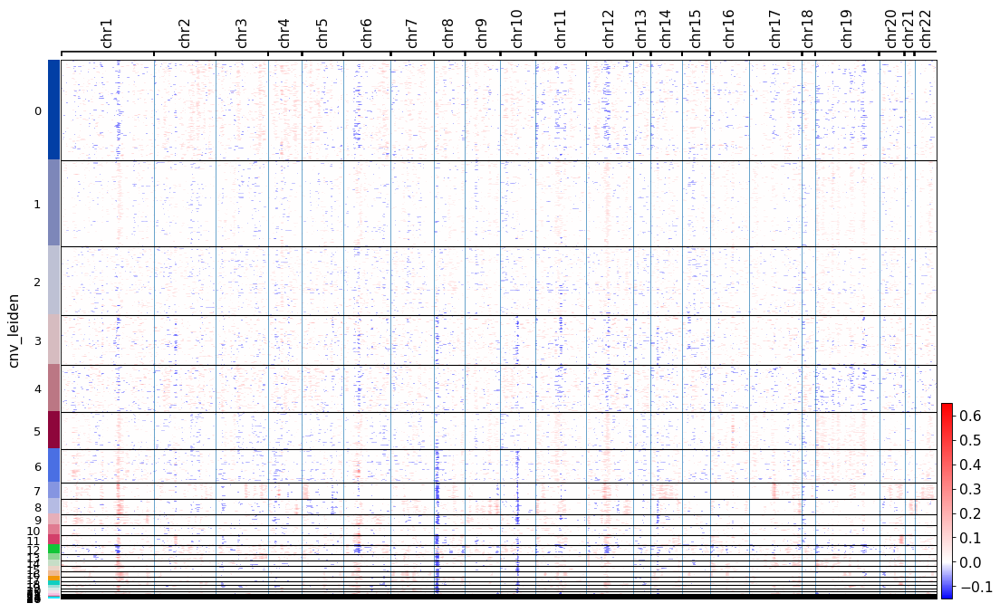

In [151]:
cnv.pl.chromosome_heatmap(adata_epi)

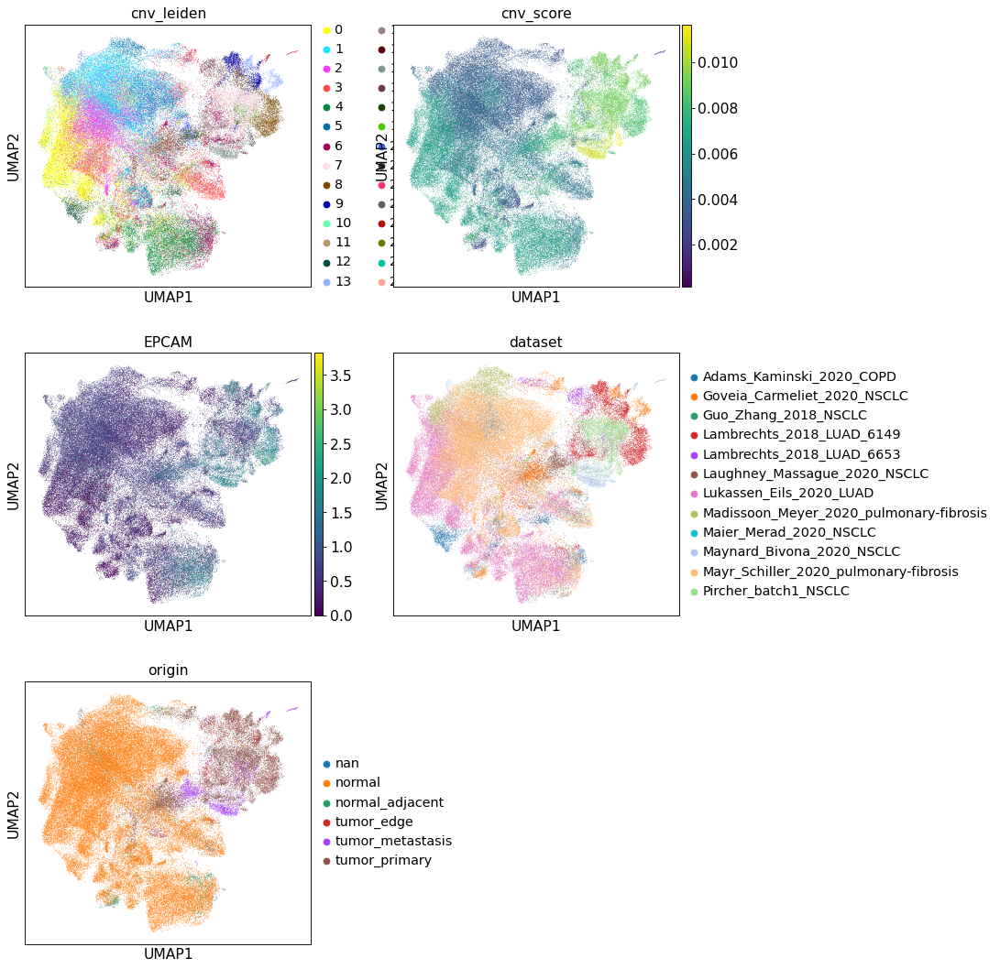

In [152]:
sc.pl.umap(
    adata_epi, color=["cnv_leiden", "cnv_score", "EPCAM", "dataset", "origin"], ncols=2
)

Alevolar cell type 1


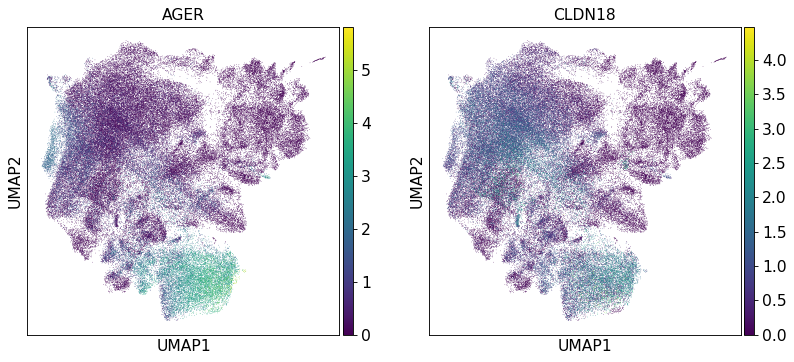

Alevolar cell type 2


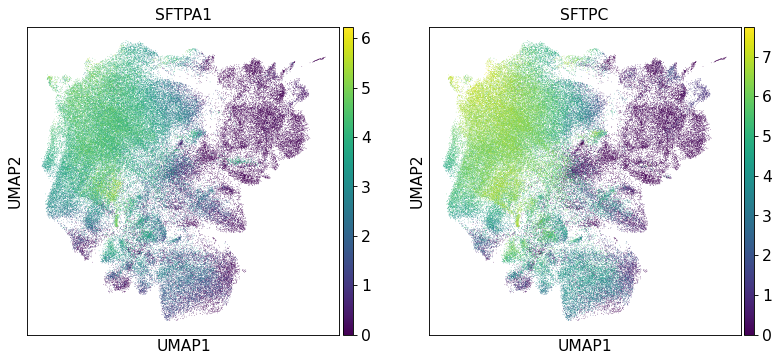

Alevolar cells (type 1 and 2)


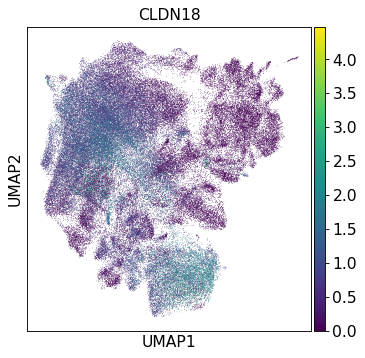

Basal


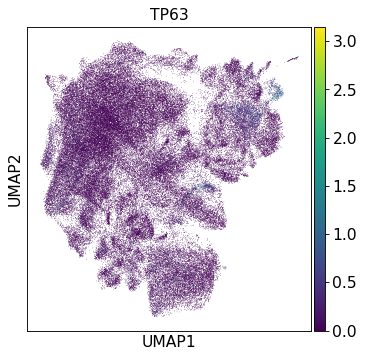

Club


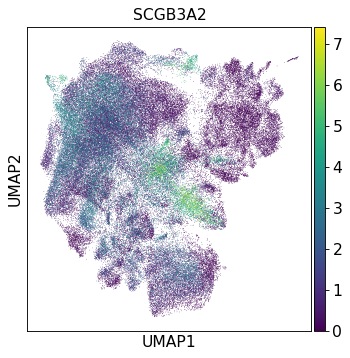

Dividing


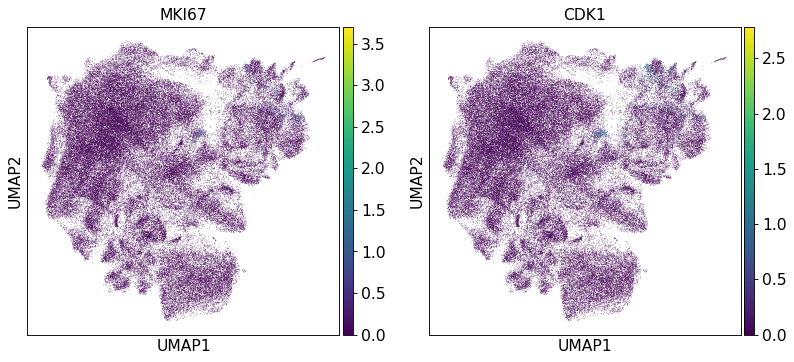

Epithelial


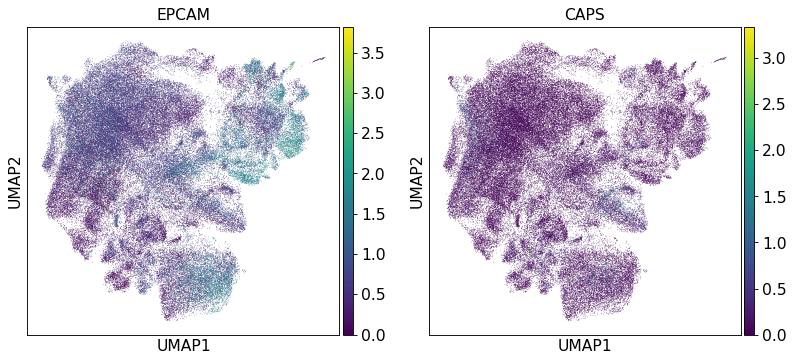

Goblet


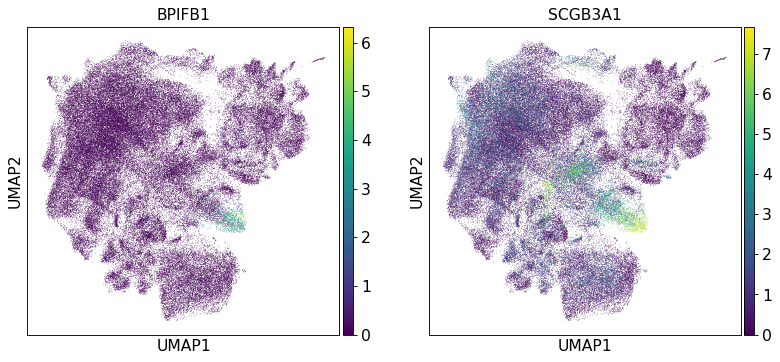

Ionocyte


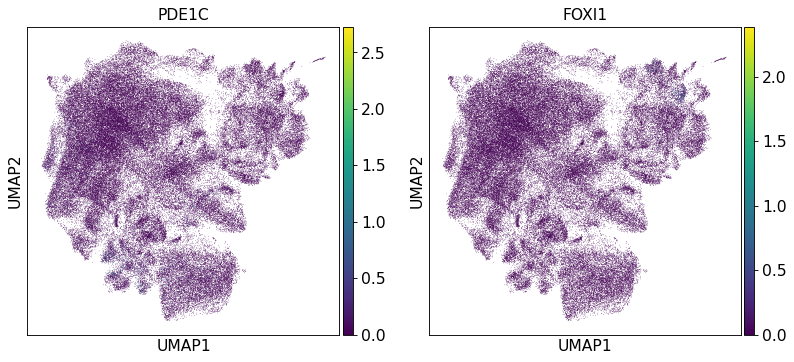

Mesothelial


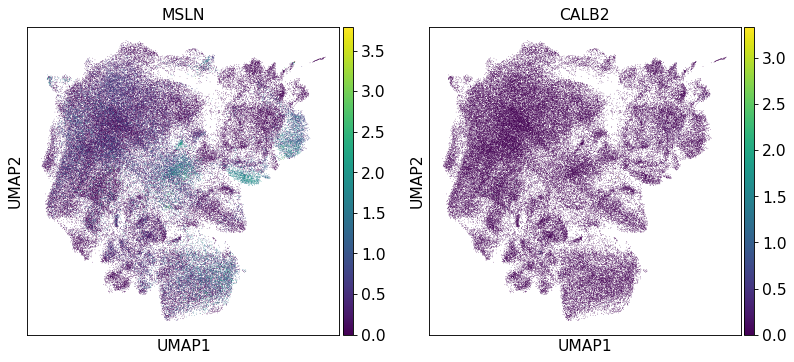

Suprabasal


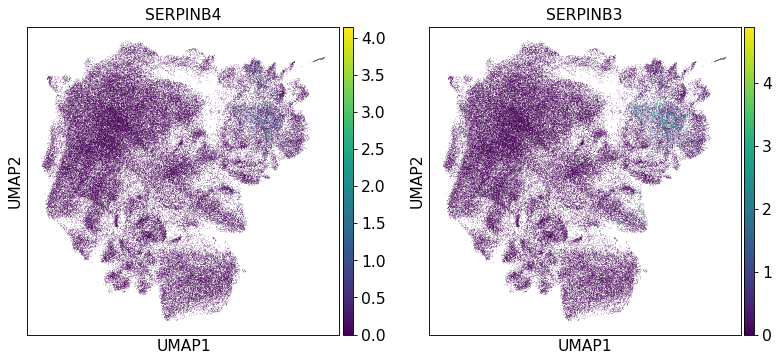

In [153]:
ah.plot_umap(
    adata_epi,
    filter_cell_type=[
        "Alevolar",
        "Basal",
        "Club",
        "Dividing",
        "Goblet",
        "Ionocyte",
        "Mesothelial",
        "Suprabasal",
        "Epi",
    ],
)

Marker MIR205HG for Basal not in adata.var


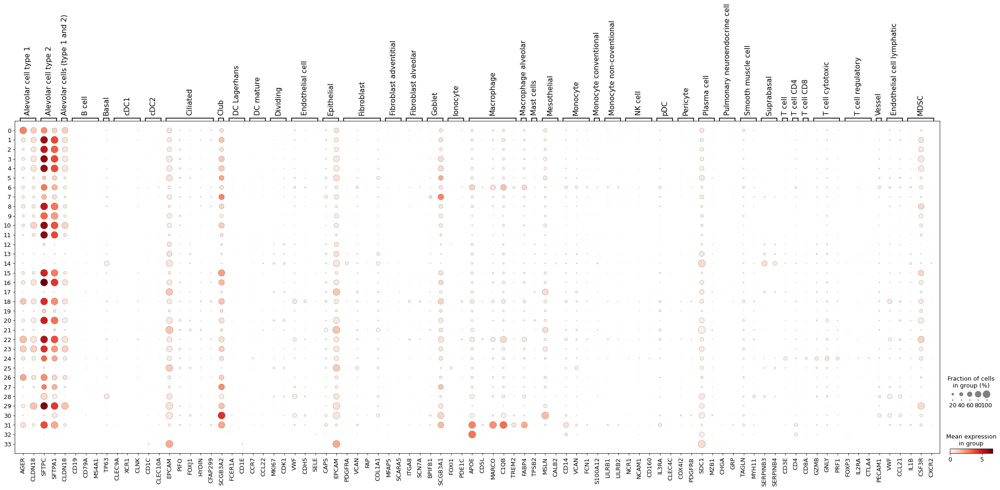

In [167]:
ah.plot_dotplot(adata_epi)

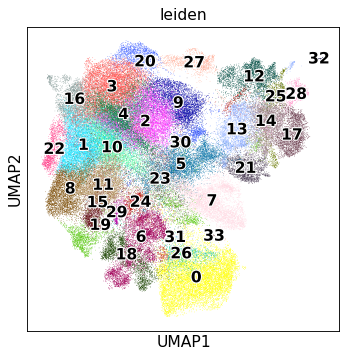

In [154]:
sc.pl.umap(adata_epi, color="leiden", legend_loc="on data", legend_fontoutline=2)

In [176]:
ct_map = {
    "Epithelial cell (malignant)": [12, 25, 28, 14, 17, 13, 21, 32],
    "Alevolar cell type 1": [0, 26, 18],
    "Alevolar cell type 2": [16, 3, 4, 2, 9, 20, 27, 22, 1, 10, 8, 11, 15, 29, 30],
    "Club/Goblet": [7, 5, 23],
    "Epithelial cell other (benign)": [6, 24, 19, 31],
}

... storing 'cell_type' as categorical


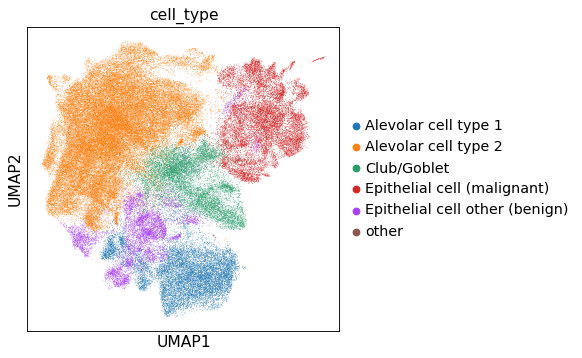

In [177]:
ah.annotate_cell_types(adata_epi, ct_map)

... storing 'cell_type' as categorical


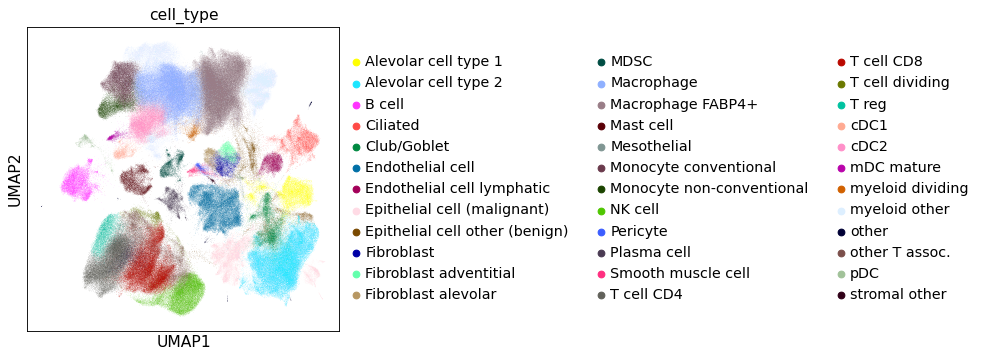

In [178]:
ah.integrate_back(adata, adata_epi)

In [179]:
adata.obs["is_malignant"] = [
    "malignant" if x else "non-malignant"
    for x in adata.obs["cell_type"].str.contains("mali")
]

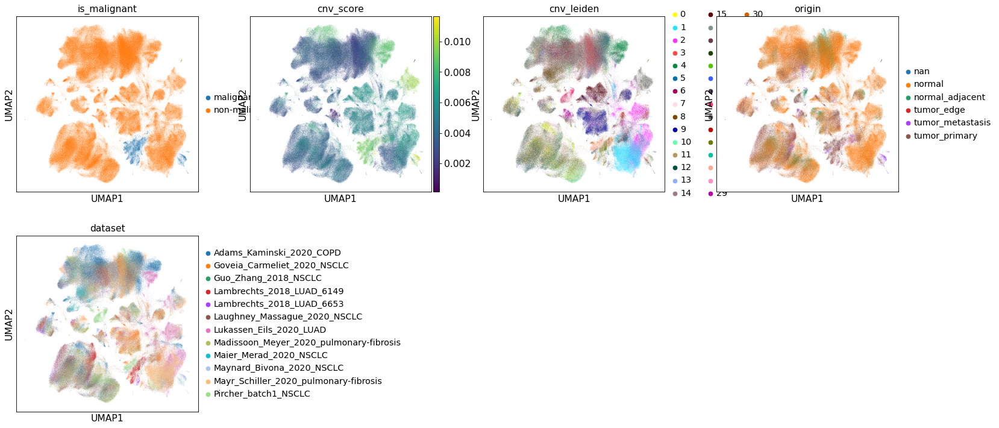

In [181]:
sc.pl.umap(adata, color=["is_malignant", "cnv_score", "cnv_leiden", "origin", "dataset"])

In [182]:
adata.obs["condition_origin"] = [
    f"{condition}_{origin}"
    for condition, origin in zip(adata.obs["condition"], adata.obs["origin"])
]

In [183]:
adata.write_h5ad("../../data/60_infercnv/all-annotated-integrated.h5ad")

... storing 'condition_origin' as categorical


In [184]:
!mkdir -p ../../tables/single_cell_annotations/all_integrated

In [185]:
adata_scvi = sc.AnnData(
    X=adata.obsm["X_scANVI"], obs=adata.obs.loc[:, ["cell_type", "cnv_leiden"]]
)
adata_scvi.write_h5ad(
    "../../tables/single_cell_annotations/all_integrated/adata_scvi.h5ad",
    compression="gzip",
    compression_opts=9,
)

In [186]:
adata.obs.loc[:, ["cell_type", "cnv_leiden"]].to_csv(
    "../../tables/single_cell_annotations/all_integrated/cell_type_annotations.csv"
)